# Итоговый проект (Детекция и классификация дорожных знаков)

**Цель:** Разработать приложение, которое обнаруживает и классифицирует дорожные знаки на картинке, видео или в реальном времени.

**Задачи:**
- Выбрать подходящий датасет и модель.
- Провести первичный анализ данных.
- Подготовить датасет для обучения.
- Обучить модель
- Сделать приложение при помощи Gradio или Streamlit для обнаружения и классификации дорожных знаков.



Выбран датасет с платформы Kaggle [RTSD (Russian Traffic Sign Dataset)](https://www.kaggle.com/datasets/watchman/rtsd-dataset). Он содержит видеокадры дорожной обстановки (разрешение 1280×720 – 1920×1080), снятые с бортового регистратора в разных сезонах, в разное время суток и при разной погоде.

В качестве обучаемой модели выбраны модели [YOLO11](https://docs.ultralytics.com/ru/models/yolo11/) и [YOLO12](https://docs.ultralytics.com/ru/models/yolo12/).

## Импорты

In [ ]:
# Откатим версию библиотеки kaggle чтобы не было ошибки KeyError: 'username' для Colab
!pip install kaggle==1.6.17

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.7/82.7 kB 7.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for kaggle: filename=kaggle-1.6.17-py3-none-any.whl size=105787 sha256=f75975378f483a7298e91def8cec8edbe812f839acdee33cac47434629203bab
  Stored in directory: /root/.cache/pip/wheels/ff/55/fb/b27a466be754d2a06ffe0e37b248d844f090a63b51becea85d
Successfully built kaggle
  Attempting uninstall: kaggle
    Found existing installation: kaggle 1.7.4.5
    Uninstalling kaggle-1.7.4.5:
      Successfully uninstalled kaggle-1.7.4.5


In [ ]:
!pip install ultralytics

   ---------------------------------------- 0.0/1.0 MB ? eta -:--:--
   -------------------- ------------------- 0.5/1.0 MB 5.6 MB/s eta 0:00:01
   ---------------------------------------- 1.0/1.0 MB 5.0 MB/s eta 0:00:00



[notice] A new release of pip is available: 24.3.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [ ]:
from zipfile import ZipFile
from tqdm import tqdm
import os
import random
import json
import numpy as np
import pandas as pd
import shutil
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from collections import Counter, defaultdict
import torch
import torchvision.transforms as T
from torch.utils.data import Dataset, DataLoader
import cv2
import albumentations as A
from IPython.display import Video as IPVideo, display
from pathlib import Path
import math
import yaml
from ultralytics import YOLO
from IPython import display
from IPython.display import Video, display, HTML
import subprocess
from uuid import uuid4
from PIL import Image, ImageDraw, ImageFont

c:\Innopolis\Project_Module_2\Final_Project\.venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [ ]:
# Зафиксируем сиды (для воспроизводимости кода)
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed_all(SEED)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

## Загрузка исходного датасета

In [ ]:
# Загрузим датасет (для Colab)
!kaggle datasets download -d watchman/rtsd-dataset

Dataset URL: https://www.kaggle.com/datasets/watchman/rtsd-dataset
License(s): unknown
100% 17.1G/17.1G [13:27<00:00, 23.6MB/s]
100% 17.1G/17.1G [13:27<00:00, 22.8MB/s]


In [ ]:
# Распакуем датасет (работает в Colab)
zip_file_path = '/content/rtsd-dataset.zip'
destination_folder = '/content/extracted_content'

try:
    with ZipFile(zip_file_path, 'r') as zip_ref:
        print(f"Extracting all files from '{zip_file_path}' to '{destination_folder}'...")
        zip_ref.extractall(destination_folder)
        print("Extraction complete.")
except FileNotFoundError:
    print(f"Error: The file '{zip_file_path}' was not found.")
except Exception as e:
    print(f"An error occurred during extraction: {e}")

Extracting all files from '/content/rtsd-dataset.zip' to '/content/extracted_content'...
Extraction complete.


In [ ]:
# Список папок и файлов (в Colab)
DATA_DIR = Path("/content/extracted_content")
IMAGES_DIR = DATA_DIR / "rtsd-frames/rtsd-frames"
LABEL_MAP = DATA_DIR / "label_map.json"
TRAIN_ANNO = DATA_DIR / "train_anno.json"
VAL_ANNO = DATA_DIR / "val_anno.json"

In [ ]:
# # скачивание с каггл в папку cache/kagglehub локально
# import kagglehub

# # Download latest version
# path = kagglehub.dataset_download("watchman/rtsd-dataset")

# print("Path to dataset files:", path)

100%|██████████| 17.1G/17.1G [1:12:05<00:00, 4.26MB/s] 

Extracting files...


Path to dataset files: C:\Users\Пользователь\.cache\kagglehub\datasets\watchman\rtsd-dataset\versions\3


## Первичный анализ

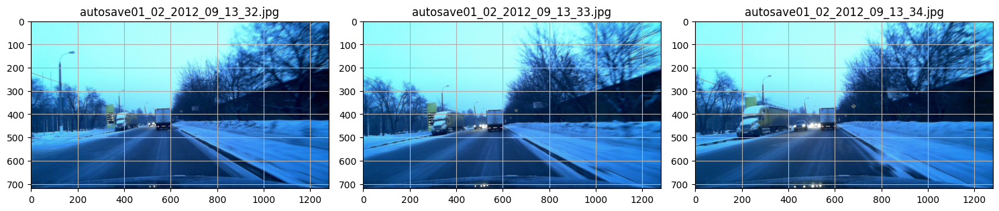

In [ ]:
# Получаем список файлов в папке
image_files = [f for f in os.listdir(IMAGES_DIR) if os.path.isfile(os.path.join(IMAGES_DIR, f))]
image_files.sort()

# Выводим первые 3 изображений
num_images_to_display = 3

plt.figure(figsize=(15, 3))  # Задаем размер фигуры для отображения нескольких изображений в ряд

for i in range(min(num_images_to_display, len(image_files))):  # Обрабатываем только первые 3 или меньше, если их меньше 3
    image_path = os.path.join(IMAGES_DIR, image_files[i])
    try:
        img = Image.open(image_path)  # Открываем изображение
        plt.subplot(1, num_images_to_display, i + 1)  # Создаем подграфик
        plt.imshow(img)  # Отображаем изображение
        plt.title(image_files[i]) # Отображаем имя файла
        # plt.axis('off')  # Отключаем оси
        plt.grid() # Сетка
    except Exception as e:
        print(f"Ошибка при открытии изображения {image_files[i]}: {e}") # Обработка ошибки, если не удалось открыть файл
        continue # Переходим к следующему файлу

plt.tight_layout()  # Автоматически корректирует параметры подграфиков для предоставления достаточного места
plt.show()

In [ ]:
print(f'Всего изображений в датасете: {len(image_files)}')

Всего изображений в датасете: 179138


In [ ]:
# Загрузка аннотаций
with open(TRAIN_ANNO, 'r') as f:
    train_anno = json.load(f)
with open(VAL_ANNO, 'r') as f:
    val_anno = json.load(f)
with open(LABEL_MAP, 'r') as f:
    label_map = json.load(f)

`train_anno` и `val_anno` имеют такой вид:

    {'images': [{'id': 0,
      'width': 1280,
      'height': 720,
      'file_name': 'rtsd-frames/autosave01_02_2012_09_13_33.jpg'},
      {'id': 1,
      'width': 1280,
      'height': 720,
      'file_name': 'rtsd-frames/autosave01_02_2012_09_13_34.jpg'},
      {'id': 2,
      'width': 1280,
      'height': 720,
      'file_name': 'rtsd-frames/autosave01_02_2012_09_13_35.jpg'}...
      ...

      {'id': 33370,
      'image_id': 20513,
      'category_id': 7,
      'area': 1520,
      'bbox': [31, 363, 40, 38],
      'iscrowd': 0},
      ...],
      'categories': [{'id': 1, 'name': '2_1'},
        {'id': 2, 'name': '1_23'},
        {'id': 3, 'name': '1_17'},
        {'id': 4, 'name': '3_24'},
        {'id': 5, 'name': '8_2_1'},
        {'id': 6, 'name': '5_20'},
        {'id': 7, 'name': '5_19_1'},
        {'id': 8, 'name': '5_16'}...

а `label_map` имеет такую структуру:

      {'2_1': 1,
      '1_23': 2,
      '1_17': 3,
      '3_24': 4,
      '8_2_1': 5,
      '5_20': 6,
      '5_19_1': 7,
      ...
      '5_17': 150,
      '1_10': 151,
      '8_16': 152,
      '7_18': 153,
      '7_14': 154,
      '8_23': 155}

In [ ]:
train_annotations = train_anno['annotations']
train_images = train_anno['images']

val_annotations = val_anno['annotations']
val_images = val_anno['images']

# Сколько всего изображений с боксами
print(f"Всего изображений с боксами в train: {len(train_images)}")
print(f"Всего изображений с боксами в val: {len(val_images)}")

# Сколько уникальных классов
class_ids_train = set([ann['category_id'] for ann in train_annotations])
print(f"Уникальных классов в train: {len(class_ids_train)}")

class_ids_val = set([ann['category_id'] for ann in val_annotations])
print(f"Уникальных классов в val: {len(class_ids_val)}")

Всего изображений с боксами в train: 54188
Всего изображений с боксами в val: 5000
Уникальных классов в train: 155
Уникальных классов в val: 139


В аннотациях номер означает номер знака по [ПДД РФ](https://www.pdd24.com/)

In [ ]:
code_to_name = {
    "2_1": "Главная дорога",
    "1_23": "Опасный поворот",
    "1_17": "Искусственная неровность",
    "3_24": "Ограничение максимальной скорости",
    "8_2_1": "Зона действия",
    "5_20": "Искусственная неровность",
    "5_19_1": "Пешеходный переход",
    "5_16": "Место остановки автобуса",
    "3_25": "Конец зоны ограничения максимальной скорости",
    "6_16": "Стоп-линия",
    "7_15": "Место стоянки такси",
    "2_2": "Конец главной дороги",
    "2_4": "Уступите дорогу",
    "8_13_1": "Направление главной дороги",
    "4_2_1": "Объезд препятствия справа",
    "1_20_3": "Сужение дороги с обеих сторон",
    "1_25": "Дорожные работы",
    "3_4": "Движение грузовых автомобилей запрещено",
    "8_3_2": "Направление действия",
    "3_4_1": "Вид транспортного средства",
    "4_1_6": "Движение направо или налево",
    "4_2_3": "Объезд препятствия слева или справа",
    "4_1_1": "Движение прямо",
    "1_33": "Прочие опасности",
    "5_15_5": "Конец полосы",
    "3_27": "Остановка запрещена",
    "1_15": "Скользкая дорога",
    "4_1_2_1": "Направления движения на следующем перекрестке",
    "6_3_1": "Место для разворота",
    "8_1_1": "Расстояние до объекта",
    "6_7": "Подземный пешеходный переход",
    "5_15_3": "Начало полосы",
    "7_3": "Автозаправочная станция",
    "1_19": "Опасная обочина",
    "6_4": "Парковка",
    "8_1_4": "Расстояние до объекта",
    "8_8": "Платные услуги",
    "1_16": "Неровная дорога",
    "1_11_1": "Опасный поворот первый направо",
    "6_6": "Надземный пешеходный переход",
    "5_15_1": "Направления движения по полосам",
    "7_2": "Больница",
    "5_15_2": "Направления движения по полосе",
    "7_12": "Пост дорожно-патрульной службы",
    "3_18": "Поворот направо запрещен",
    "5_6": "Конец дороги с односторонним движением",
    "5_5": "Дорога с односторонним движением",
    "7_4": "Техническое обслуживание автомобилей",
    "4_1_2": "Движение направо",
    "8_2_2": "Зона действия",
    "7_11": "Пункт питания",
    "1_22": "Пешеходный переход",
    "1_27": "Выброс гравия",
    "2_3_2": "Примыкание второстепенной дороги",
    "5_15_2_2": "Направления движения по полосе",
    "1_8": "Светофорное регулирование",
    "3_13": "Ограничение высоты",
    "2_3": "Пересечение с второстепенной дорогой",
    "8_3_3": "Направление действия",
    "2_3_3": "Примыкание второстепенной дороги",
    "7_7": "Пункт контроля международных автомобильных перевозок",
    "1_11": "Опасный поворот",
    "8_13": "Направление главной дороги",
    "1_12_2": "Опасные повороты первый налево",
    "1_20": "Сужение дороги",
    "1_12": "Опасные повороты",
    "3_32": "Движение транспортных средств с опасными грузами запрещено",
    "2_5": "Движение без остановки запрещено",
    "3_1": "Въезд запрещен",
    "4_8_2": "Направление движения транспортных средств с опасными грузами",
    "3_20": "Обгон запрещен",
    "3_2": "Движение механических транспортных средств запрещено",
    "2_3_6": "Примыкание второстепенной дороги",
    "5_22": "Конец населенного пункта",
    "5_18": "Направление движения к населенному пункту",
    "2_3_5": "Примыкание второстепенной дороги",
    "7_5": "Мойка автомобилей",
    "8_4_1": "Вид транспортного средства",
    "3_14": "Ограничение ширины",
    "1_2": "Железнодорожный переезд без шлагбаума",
    "1_20_2": "Сужение дороги слева",
    "4_1_4": "Движение прямо или направо",
    "7_6": "Телефон",
    "8_1_3": "Расстояние до объекта",
    "8_3_1": "Направление действия",
    "4_3": "Круговое движение",
    "4_1_5": "Движение прямо или налево",
    "8_2_3": "Зона действия",
    "8_2_4": "Зона действия",
    "1_31": "Тоннель",
    "3_10": "Движение пешеходов запрещено",
    "4_2_2": "Объезд препятствия слева",
    "7_1": "Пункт медицинской помощи",
    "3_28": "Стоянка запрещена",
    "4_1_3": "Движение налево",
    "5_4": "Конец дороги с полосой для маршрутных транспортных средств",
    "5_3": "Дорога для автомобилей",
    "6_8_2": "Тупик",
    "3_31": "Конец зоны всех ограничений",
    "6_2": "Рекомендуемая скорость",
    "1_21": "Двустороннее движение",
    "3_21": "Конец зоны запрещения обгона",
    "1_13": "Крутой спуск",
    "1_14": "Крутой подъем",
    "2_3_4": "Примыкание второстепенной дороги",
    "4_8_3": "Направление движения транспортных средств с опасными грузами",
    "6_15_2": "Направление движения для грузовых автомобилей",
    "2_6": "Преимущество встречного движения",
    "3_18_2": "Поворот налево запрещен",
    "4_1_2_2": "Направления движения на следующем перекрестке",
    "1_7": "Пересечение с круговым движением",
    "3_19": "Разворот запрещен",
    "1_18": "Выброс гравия",
    "2_7": "Преимущество перед встречным движением",
    "8_5_4": "Время действия",
    "5_15_7": "Направление движения по полосам",
    "5_14": "Полоса для маршрутных транспортных средств",
    "5_21": "Жилая зона",
    "1_1": "Железнодорожный переезд со шлагбаумом",
    "6_15_1": "Направление движения для грузовых автомобилей",
    "8_6_4": "Способ постановки транспортного средства на стоянку",
    "8_15": "Слепые пешеходы",
    "4_5": "Пешеходная дорожка",
    "3_11": "Ограничение массы",
    "8_18": "Инвалиды",
    "8_4_4": "Вид транспортного средства",
    "3_30": "Стоянка запрещена по четным числам месяца",
    "5_7_1": "Выезд на дорогу с полосой для маршрутных транспортных средств",
    "5_7_2": "Выезд на дорогу с полосой для маршрутных транспортных средств",
    "1_5": "Пересечение с трамвайной линией",
    "3_29": "Стоянка запрещена по нечетным числам месяца",
    "6_15_3": "Направление движения для грузовых автомобилей",
    "5_12": "Конец дороги с полосой для велосипедистов",
    "3_16": "Ограничение минимальной дистанции",
    "1_30": "Низколетящие самолеты",
    "5_11": "Дорога с полосой для велосипедистов",
    "1_6": "Пересечение равнозначных дорог",
    "8_6_2": "Способ постановки транспортного средства на стоянку",
    "6_8_3": "Тупик",
    "3_12": "Ограничение массы, приходящейся на ось транспортного средства",
    "3_33": "Движение транспортных средств с опасными грузами запрещено",
    "8_4_3": "Вид транспортного средства",
    "5_8": "Реверсивное движение",
    "8_14": "Полоса движения",
    "8_17": "Таможня",
    "3_6": "Движение тракторов запрещено",
    "1_26": "Перегон скота",
    "8_5_2": "Время действия",
    "6_8_1": "Тупик",
    "5_17": "Велосипедная дорожка",
    "1_10": "Выезд на набережную",
    "8_16": "Влажное покрытие",
    "7_18": "Общественный телефон",
    "7_14": "Пункт контроля транспортных средств",
    "8_23": "Фотовидеофиксация"
}

**[1. Предупреждающие знаки](https://www.pdd24.com/pdd/znak1)**

- "1_23": "Опасный поворот",
- "1_17": "Искусственная неровность",
- "1_20_3": "Сужение дороги с обеих сторон",
- "1_25": "Дорожные работы",
- "1_33": "Прочие опасности",
- "1_15": "Скользкая дорога",
- "1_19": "Опасная обочина",
- "1_16": "Неровная дорога",
- "1_11_1": "Опасный поворот первый направо",
- "1_22": "Пешеходный переход",
- "1_27": "Выброс гравия", 1_18
- "1_8": "Светофорное регулирование",
- "1_11": "Опасный поворот",
- "1_12_2": "Опасные повороты первый налево",
- "1_20": "Сужение дороги",
- "1_12": "Опасные повороты",
- "1_2": "Железнодорожный переезд без шлагбаума",
- "1_20_2": "Сужение дороги слева",
- "1_31": "Тоннель",
- "1_21": "Двустороннее движение",
- "1_13": "Крутой спуск",
- "1_14": "Крутой подъем",
- "1_7": "Пересечение с круговым движением",
- "1_18": "Выброс гравия",
- "1_1": "Железнодорожный переезд со шлагбаумом",
- "1_5": "Пересечение с трамвайной линией",
- "1_30": "Низколетящие самолеты",
- "1_6": "Пересечение равнозначных дорог",
- "1_26": "Перегон скота",
- "1_10": "Выезд на набережную"


**[2. Знаки приоритета](https://www.pdd24.com/pdd/znak2)**

- "2_1": "Главная дорога",
- "2_2": "Конец главной дороги",
- "2_4": "Уступите дорогу",
- "2_3_2": "Примыкание второстепенной дороги",
- "2_3": "Пересечение с второстепенной дорогой",
- "2_3_3": "Примыкание второстепенной дороги",
- "2_5": "Движение без остановки запрещено",
- "2_3_6": "Примыкание второстепенной дороги",
- "2_3_5": "Примыкание второстепенной дороги",
- "2_3_4": "Примыкание второстепенной дороги",
- "2_6": "Преимущество встречного движения",
- "2_7": "Преимущество перед встречным движением"
    

**[3. Запрещающие знаки](https://www.pdd24.com/pdd/znak3)**

- "3_24": "Ограничение максимальной скорости",
- "3_25": "Конец зоны ограничения максимальной скорости",
- "3_4": "Движение грузовых автомобилей запрещено",
- **"3_4_1": "Вид транспортного средства" = 8_4_1 Знаки дополнительной информации**
- "3_27": "Остановка запрещена",
- "3_18": "Поворот направо запрещен",
- "3_13": "Ограничение высоты",
- "3_32": "Движение транспортных средств с опасными грузами запрещено",
- "3_1": "Въезд запрещен",
- "3_20": "Обгон запрещен",
- "3_2": "Движение механических транспортных средств запрещено", 3_3
- "3_14": "Ограничение ширины",
- "3_10": "Движение пешеходов запрещено",
- "3_28": "Стоянка запрещена",
- "3_31": "Конец зоны всех ограничений",
- "3_21": "Конец зоны запрещения обгона",
- "3_18_2": "Поворот налево запрещен",
- "3_19": "Разворот запрещен",
- "3_11": "Ограничение массы",
- "3_30": "Стоянка запрещена по четным числам месяца",
- "3_29": "Стоянка запрещена по нечетным числам месяца",
- "3_16": "Ограничение минимальной дистанции",
- "3_12": "Ограничение массы, приходящейся на ось транспортного средства",
- "3_33": "Движение транспортных средств с опасными грузами запрещено",
- "3_6": "Движение тракторов запрещено"


**[4. Предписывающие знаки](https://www.pdd24.com/pdd/znak4)**

- "4_2_1": "Объезд препятствия справа",
- "4_1_6": "Движение направо или налево",
- "4_2_3": "Объезд препятствия слева или справа",
- "4_1_1": "Движение прямо",
- **"4_1_2_1": "Направления движения на следующем перекрестке" = 5.36д?**
- "4_1_2": "Движение направо",
- "4_8_2": "Направление движения транспортных средств с опасными грузами",
- "4_1_4": "Движение прямо или направо",
- "4_3": "Круговое движение",
- "4_1_5": "Движение прямо или налево",
- "4_2_2": "Объезд препятствия слева",
- "4_1_3": "Движение налево",
- "4_8_3": "Направление движения транспортных средств с опасными грузами",
- **"4_1_2_2": "Направления движения на следующем перекрестке"= 5.36д?**,
- "4_5": "Пешеходная дорожка"



**[5. Знаки особых предписаний](https://www.pdd24.com/pdd/znak5)**

- "5_20": "Искусственная неровность",
- "5_19_1": "Пешеходный переход",
- "5_16": "Место остановки автобуса",
- "5_15_5": "Конец полосы",
- "5_15_3": "Начало полосы",
- "5_15_1": "Направления движения по полосам",
- "5_15_2": "Направления движения по полосе",
- "5_6": "Конец дороги с односторонним движением",
- "5_5": "Дорога с односторонним движением",
- "5_15_2_2": "Направления движения по полосе",
- "5_22": "Конец населенного пункта", 5_24_1, 5_24_2
- "5_18": "Направление движения к населенному пункту",**?**
- "5_4": "Конец дороги с полосой для маршрутных транспортных средств", 5_12_1
- "5_3": "Дорога для автомобилей",
- "5_15_7": "Направление движения по полосам",
- "5_14": "Полоса для маршрутных транспортных средств",
- "5_21": "Жилая зона",
- "5_7_1": "Выезд на дорогу с полосой для маршрутных транспортных средств", 5_13_1
- "5_7_2": "Выезд на дорогу с полосой для маршрутных транспортных средств", 5_13_2
- "5_12": "Конец дороги с полосой для велосипедистов",
- "5_11": "Дорога с полосой для велосипедистов",
- "5_8": "Реверсивное движение",
- "5_17": "Велосипедная дорожка" **?**


**[6. Информационные знаки](https://www.pdd24.com/pdd/znak6)**

- "6_16": "Стоп-линия",
- "6_3_1": "Место для разворота",
- "6_7": "Подземный пешеходный переход",
- "6_4": "Парковка",
- "6_6": "Надземный пешеходный переход",
- "6_8_2": "Тупик",
- "6_2": "Рекомендуемая скорость",
- "6_15_2": "Направление движения для грузовых автомобилей",
- "6_15_1": "Направление движения для грузовых автомобилей",
- "6_15_3": "Направление движения для грузовых автомобилей",
- "6_8_3": "Тупик",
- "6_8_1": "Тупик"


**[7. Знаки сервиса](https://www.pdd24.com/pdd/znak7)**
- **"7_15": "Место стоянки такси" = 5_18 Знаки особых предписаний**
- "7_3": "Автозаправочная станция",
- "7_2": "Больница",
- "7_12": "Пост дорожно-патрульной службы",
- "7_4": "Техническое обслуживание автомобилей",
- "7_11": "Пункт питания",
- "7_7": "Пункт контроля международных автомобильных перевозок" ?
- "7_5": "Мойка автомобилей",
- "7_6": "Телефон",
- "7_1": "Пункт медицинской помощи",
- "7_18": "Общественный телефон", 7_6
- "7_14": "Пункт контроля транспортных средств"


**[8. Знаки дополнительной информации](https://www.pdd24.com/pdd/znak8)**

- "8_2_1": "Зона действия",
- "8_13_1": "Направление главной дороги",
- "8_3_2": "Направление действия",
- "8_1_1": "Расстояние до объекта",
- "8_1_4": "Расстояние до объекта",
- "8_8": "Платные услуги",
- "8_2_2": "Зона действия",
- "8_3_3": "Направление действия",
- "8_13": "Направление главной дороги",
- "8_4_1": "Вид транспортного средства",
- "8_1_3": "Расстояние до объекта",
- "8_3_1": "Направление действия",
- "8_2_3": "Зона действия",
- "8_2_4": "Зона действия",
- "8_5_4": "Время действия",
- "8_6_4": "Способ постановки транспортного средства на стоянку",
- "8_15": "Слепые пешеходы",
- "8_18": "Инвалиды", 8_17
- "8_4_4": "Вид транспортного средства",
- "8_6_2": "Способ постановки транспортного средства на стоянку",
- "8_4_3": "Вид транспортного средства",
- "8_14": "Полоса движения",
- "8_17": "Таможня" ?,
- "8_5_2": "Время действия",
- "8_16": "Влажное покрытие",
- "8_23": "Фотовидеофиксация"


В разметке знаков есть некоторые ошибки, не все метки соответствуют своим группам знаков. Пока не будем это исправлять, посмотрим что получится после обучения модели.

In [ ]:
def plot_images_with_annotations(
    images_list,
    annotations,
    label_map=None,
    code_to_name=None,
    use_category_name: bool = False,
):
    '''
    Визуализирует изображения с аннотациями:

    - use_category_name=True → показывает полные названия (например, "Главная дорога");
    - use_category_name=False → показывает коды (например, "2_1").
    '''

    reverse_label_map = {v: k for k, v in label_map.items()} if label_map else {}

    # Автозаполнение кодов и имён, если нужно
    for ann in annotations:
        category_id = ann["category_id"]
        label_code = reverse_label_map.get(category_id, "Unknown")
        ann["label_code"] = label_code  # Например, "2_1"
        ann["category_name"] = code_to_name.get(label_code, label_code)  # Например, "Главная дорога"

    for sample in images_list:
        img_path = IMAGES_DIR / Path(sample["file_name"]).name
        try:
            img = Image.open(img_path).convert("RGB")
            width_px, height_px = img.size
            dpi = 100
            figsize = (width_px / dpi, height_px / dpi)
        except FileNotFoundError:
            print(f"Файл не найден: {img_path}")
            continue

        fig, ax = plt.subplots(figsize=figsize, dpi=dpi)
        ax.imshow(img)

        img_annos = [a for a in annotations if a["image_id"] == sample["id"]]

        for ann in img_annos:
            x, y, w, h = ann["bbox"]

            label_name = ann["category_name"] if use_category_name else ann["label_code"]

            ax.add_patch(patches.Rectangle((x, y), w, h, fill=False,
                                           edgecolor="lime", linewidth=1.5))
            text_y = y - 8 if y > 20 else y + h + 12
            ax.text(x + 5, text_y, label_name,
                    fontsize=8, color="white", bbox=dict(facecolor="green", alpha=0.7))

        ax.axis("off")
        plt.tight_layout()
        plt.show()

In [ ]:
random.seed(SEED)
sample_images = random.sample(train_images, 5)

plot_images_with_annotations(
    images_list=sample_images,
    annotations=train_annotations,
    label_map=label_map,
    code_to_name=code_to_name,
    use_category_name=False
)

In [ ]:
random.seed(SEED)
sample_images = random.sample(train_images, 5)

plot_images_with_annotations(
    images_list=sample_images,
    annotations=train_annotations,
    label_map=label_map,
    code_to_name=code_to_name,
    use_category_name=True
)

In [ ]:
# Обратный label_map
reverse_label_map = {v: k for k, v in label_map.items()}

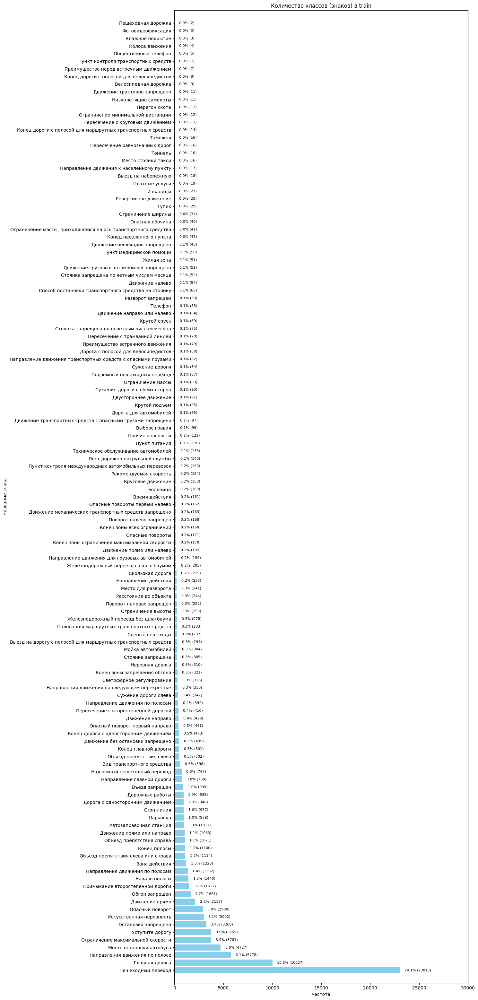

In [ ]:
# Для train данных
# Добавляем category_name в аннотации, если нет
for ann in train_annotations:
    if "category_name" not in ann:
        code = reverse_label_map.get(ann["category_id"], "Unknown")
        ann["category_name"] = code_to_name.get(code, code)

# Подсчёт количества каждой категории
category_counter = Counter(ann["category_name"] for ann in train_annotations)

# Сортировка по убыванию
sorted_counts = category_counter.most_common()
labels, counts = zip(*sorted_counts)

# Общая сумма объектов
total = sum(counts)

# Построение горизонтального графика
plt.figure(figsize=(15, len(labels) * 0.25))  # высота зависит от количества категорий
bars = plt.barh(labels, counts, color='skyblue')
plt.title("Количество классов (знаков) в train")
plt.xlabel("Частота")
plt.ylabel("Название знака")
plt.margins(y=0.01)
ax = plt.gca()
ax.set_xlim(0, 30000)

# Добавляем подписи справа от столбцов
for bar, count in zip(bars, counts):
    width = bar.get_width()
    percent = 100 * count / total
    text = f"{percent:.1f}% ({count})"
    plt.text(width + total * 0.005, bar.get_y() + bar.get_height() / 2,
             text, va='center', fontsize=8)

plt.tight_layout()
plt.show()

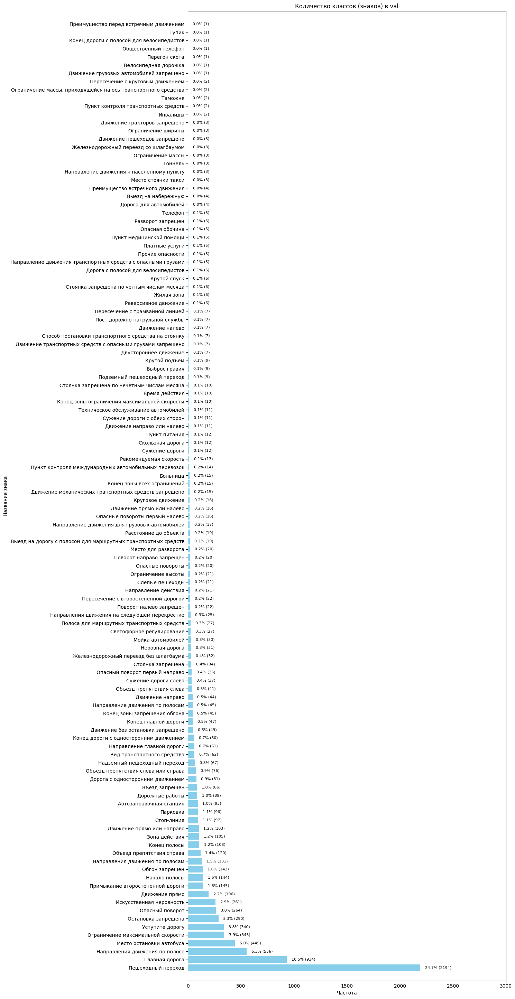

In [ ]:
# Для val данных
# Добавляем category_name в аннотации, если нет
for ann in val_annotations:
    if "category_name" not in ann:
        code = reverse_label_map.get(ann["category_id"], "Unknown")
        ann["category_name"] = code_to_name.get(code, code)

# Подсчёт количества каждой категории
category_counter = Counter(ann["category_name"] for ann in val_annotations)

# Сортировка по убыванию
sorted_counts = category_counter.most_common()
labels, counts = zip(*sorted_counts)

# Общая сумма объектов
total = sum(counts)

# Построение горизонтального графика
plt.figure(figsize=(15, len(labels) * 0.25))  # высота зависит от количества категорий
bars = plt.barh(labels, counts, color='skyblue')
plt.title("Количество классов (знаков) в val")
plt.xlabel("Частота")
plt.ylabel("Название знака")
plt.margins(y=0.01)
ax = plt.gca()
ax.set_xlim(0, 3000)

# Добавляем подписи справа от столбцов
for bar, count in zip(bars, counts):
    width = bar.get_width()
    percent = 100 * count / total
    text = f"{percent:.1f}% ({count})"
    plt.text(width + total * 0.005, bar.get_y() + bar.get_height() / 2,
             text, va='center', fontsize=8)

plt.tight_layout()
plt.show()

Видим, что дисбаланс классов гигантский, каких то знаков очень мало, а каких то очень много. Данную проблему можно решить добавлением аугментаций для категорий знаков, которых мало.

## Аугментация изображений и боксов

In [ ]:
# YOLO структура
YOLO_IMAGES = DATA_DIR / "YOLO_FORMAT/images/train"
YOLO_LABELS = DATA_DIR / "YOLO_FORMAT/labels/train"

YOLO_IMAGES.mkdir(parents=True, exist_ok=True)
YOLO_LABELS.mkdir(parents=True, exist_ok=True)

# # Очистка и создание папок заново
# for path in [YOLO_IMAGES, YOLO_LABELS]:
#     if path.exists():
#         shutil.rmtree(path)
#     path.mkdir(parents=True, exist_ok=True)

In [ ]:
# bbox конвертеры
def coco_to_yolo(bbox, img_w, img_h):
    x, y, w, h = bbox
    x_center = (x + w / 2) / img_w
    y_center = (y + h / 2) / img_h
    return [x_center, y_center, w / img_w, h / img_h]

In [ ]:
# Albumentations аугментации
def get_augmentation():
    return A.Compose([
        A.Rotate(limit=45, p=0.7),
        A.RandomBrightnessContrast(p=0.5),
        A.CLAHE(p=0.3),
        A.HorizontalFlip(p=0.5),
        A.Perspective(scale=(0.05, 0.1), p=0.3),
        A.Affine(translate_percent=0.05, rotate=(-15, 15), scale=(0.9, 1.1), shear=5, p=0.7)
    ], bbox_params=A.BboxParams(format='yolo', min_area=10, min_visibility=0.1, label_fields=['category_id']))

In [ ]:
# Подготовка
TARGET_COUNT_PER_CLASS = 500
image_id_to_image = {img["id"]: img for img in train_anno["images"]}
train_annotations = train_anno["annotations"]

class_obj_count = Counter()
class_image_ids = defaultdict(set)
for ann in train_annotations:
    class_id = ann["category_id"]
    class_obj_count[class_id] += 1
    class_image_ids[class_id].add(ann["image_id"])

augment_plan = {}
for class_id, count in class_obj_count.items():
    if count < TARGET_COUNT_PER_CLASS:
        img_ids = class_image_ids[class_id]
        needed = TARGET_COUNT_PER_CLASS - count
        copies_per_image = math.ceil(needed / len(img_ids))
        augment_plan[class_id] = {
            "needed": needed,
            "images": img_ids,
            "copies_per_image": copies_per_image
        }

image_to_anns = defaultdict(list)
for ann in train_annotations:
    image_to_anns[ann["image_id"]].append(ann)

print(f"Всего изображений в train: {len(train_anno['images'])}")
print(f"Всего аннотаций в train: {len(train_anno['annotations'])}")
print(f"Редких классов: {len(augment_plan)}")


Всего изображений в train: 54188
Всего аннотаций в train: 95492
Редких классов: 121


In [ ]:
def generate_augmented_train_dataset(
    train_anno_path: Path,
    image_root: Path,
    final_img_dir: Path,
    final_lbl_dir: Path,
    augment_plan: dict,
    image_id_to_image: dict,
    image_to_anns: dict,
    coco_to_yolo,
    get_augmentation,
    code_to_name: dict,
    reverse_label_map: dict
):
    """
    1) Копирует оригинальные train‑изображения и аннотации в YOLO‑формат
    2) Добавляет аугментированные изображения и аннотации
    """
    ordered_codes = list(code_to_name.keys())

    # очистка
    for p in (final_img_dir, final_lbl_dir):
        if p.exists():
            shutil.rmtree(p)
        p.mkdir(parents=True, exist_ok=True)

    # 1. оригинальные
    with open(train_anno_path, 'r') as f:
        train_data = json.load(f)
    id_to_anns = defaultdict(list)
    for ann in train_data["annotations"]:
        id_to_anns[ann["image_id"]].append(ann)

    for img_meta in tqdm(train_data["images"], desc="Конвертация оригинальных"):
        fname = Path(img_meta["file_name"]).name
        src = image_root / fname
        dst_img = final_img_dir / fname
        dst_lbl = final_lbl_dir / fname.replace(".jpg", ".txt")
        if not src.exists():
            continue
        shutil.copy(src, dst_img)

        w, h = img_meta["width"], img_meta["height"]
        anns = id_to_anns.get(img_meta["id"], [])
        with open(dst_lbl, 'w') as f:
            for ann in anns:
                code = reverse_label_map.get(ann["category_id"])
                if code not in ordered_codes:
                    continue
                cid = ordered_codes.index(code)
                x, y, bw, bh = ann["bbox"]
                x_c = (x + bw/2) / w
                y_c = (y + bh/2) / h
                fw = bw / w
                fh = bh / h
                f.write(f"{cid} {x_c:.6f} {y_c:.6f} {fw:.6f} {fh:.6f}\n")

    # 2. аугментация
    counter = 0
    for class_code, plan in tqdm(augment_plan.items(), desc="Аугментация"):
        for image_id in plan["images"]:
            img_meta = image_id_to_image[image_id]
            fname = Path(img_meta["file_name"]).name
            src = image_root / fname
            if not src.exists():
                continue

            img = cv2.cvtColor(cv2.imread(str(src)), cv2.COLOR_BGR2RGB)
            h, w = img.shape[:2]
            anns = image_to_anns[image_id]
            bboxes = [coco_to_yolo(a["bbox"], w, h) for a in anns]
            cats = [a["category_id"] for a in anns]

            for _ in range(plan["copies_per_image"]):
                tr = get_augmentation()(image=img, bboxes=bboxes, category_id=cats)
                new_img, new_bboxes, new_cats = tr["image"], tr["bboxes"], tr["category_id"]
                if not new_bboxes:
                    continue

                out_fname = f"aug_{class_code}_{counter}.jpg"
                dst_img = final_img_dir / out_fname
                dst_lbl = final_lbl_dir / out_fname.replace(".jpg", ".txt")

                cv2.imwrite(str(dst_img), cv2.cvtColor(new_img, cv2.COLOR_RGB2BGR))
                with open(dst_lbl, 'w') as f:
                    for bbox, cat in zip(new_bboxes, new_cats):
                        code = reverse_label_map.get(cat)
                        if code not in ordered_codes:
                            continue
                        cid = ordered_codes.index(code)
                        x, y, bw, bh = bbox
                        f.write(f"{cid} {x:.6f} {y:.6f} {bw:.6f} {bh:.6f}\n")

                counter += 1

    print(f"\nВсего изображений в итоговом train-датасете: {len(list(final_img_dir.glob('*.jpg')))}")
    print(f"Всего аннотаций: {len(list(final_lbl_dir.glob('*.txt')))}")


In [ ]:
generate_augmented_train_dataset(
    train_anno_path=TRAIN_ANNO,
    image_root=IMAGES_DIR,
    final_img_dir=Path("/content/extracted_content/YOLO_FORMAT/images/train"),
    final_lbl_dir=Path("/content/extracted_content/YOLO_FORMAT/labels/train"),
    augment_plan=augment_plan,
    image_id_to_image=image_id_to_image,
    image_to_anns=image_to_anns,
    coco_to_yolo=coco_to_yolo,
    get_augmentation=get_augmentation,
    code_to_name=code_to_name,
    reverse_label_map=reverse_label_map
)

Аугментация: 100%|██████████| 121/121 [20:06<00:00,  9.97s/it]



Всего изображений в итоговом train-датасете: 106410
Всего аннотаций: 106410


## Подготовка данных для модели YOLO

In [ ]:
def convert_coco_val_to_yolo(
    val_anno_path: Path,
    image_root: Path,
    out_img_dir: Path,
    out_lbl_dir: Path,
    code_to_name: dict,
    reverse_label_map: dict
):
    """
    Конвертирует COCO-валидацию в YOLO-формат, используя mapping через reverse_label_map → ordered_codes
    """
    ordered_codes = list(code_to_name.keys())

    # очистка
    for p in (out_img_dir, out_lbl_dir):
        if p.exists():
            shutil.rmtree(p)
        p.mkdir(parents=True, exist_ok=True)

    with open(val_anno_path, 'r') as f:
        val_data = json.load(f)

    id_to_anns = defaultdict(list)
    for ann in val_data["annotations"]:
        id_to_anns[ann["image_id"]].append(ann)

    for img_meta in tqdm(val_data["images"], desc="Конвертация val"):
        fname = Path(img_meta["file_name"]).name
        src = image_root / fname
        dst_img = out_img_dir / fname
        dst_lbl = out_lbl_dir / fname.replace(".jpg", ".txt")
        if not src.exists():
            continue
        shutil.copy(src, dst_img)

        w, h = img_meta["width"], img_meta["height"]
        anns = id_to_anns.get(img_meta["id"], [])
        with open(dst_lbl, 'w') as f:
            for ann in anns:
                code = reverse_label_map.get(ann["category_id"])
                if code not in ordered_codes:
                    continue
                cid = ordered_codes.index(code)
                x, y, bw, bh = ann["bbox"]
                x_c = (x + bw/2) / w
                y_c = (y + bh/2) / h
                fw = bw / w
                fh = bh / h
                f.write(f"{cid} {x_c:.6f} {y_c:.6f} {fw:.6f} {fh:.6f}\n")

    print(f"\nВалидационные изображения сохранены: {len(list(out_img_dir.glob('*.jpg')))}")
    print(f"YOLO аннотаций: {len(list(out_lbl_dir.glob('*.txt')))}")

In [ ]:
convert_coco_val_to_yolo(
    val_anno_path=VAL_ANNO,
    image_root=IMAGES_DIR,
    out_img_dir=Path("/content/extracted_content/YOLO_FORMAT/images/val"),
    out_lbl_dir=Path("/content/extracted_content/YOLO_FORMAT/labels/val"),
    code_to_name=code_to_name,
    reverse_label_map=reverse_label_map
)

Конвертация val: 100%|██████████| 5000/5000 [00:22<00:00, 221.17it/s]


Валидационные изображения сохранены: 5000
YOLO аннотаций: 5000


In [ ]:
def yolo_to_coco(x, y, w, h, img_w, img_h):
    box_w = w * img_w
    box_h = h * img_h
    x1 = (x * img_w) - (box_w / 2)
    y1 = (y * img_h) - (box_h / 2)
    return x1, y1, box_w, box_h

def visualize_yolo_augmented(
    image_dir,
    label_dir,
    code_to_name,
    ordered_codes,
    num_samples=5,
    seed=42,
    prefix="aug_"
):
    # Собираем только файлы-augment
    image_files = [p for p in Path(image_dir).glob("*.jpg") if p.name.startswith(prefix)]
    if not image_files:
        print(f"Нет аугментированных изображений (prefix='{prefix}') в папке.")
        return

    random.seed(seed)
    samples = random.sample(image_files, min(num_samples, len(image_files)))

    for img_path in samples:
        lbl_path = Path(label_dir) / img_path.with_suffix(".txt").name
        if not lbl_path.exists():
            print(f"Нет аннотации для {img_path.name}")
            continue

        # Загрузка и отображение
        image = cv2.cvtColor(cv2.imread(str(img_path)), cv2.COLOR_BGR2RGB)
        h, w = image.shape[:2]
        with open(lbl_path) as f:
            lines = [l.strip().split() for l in f if l.strip()]

        plt.figure(figsize=(8, 6))
        plt.imshow(image)
        ax = plt.gca()

        for parts in lines:
            if len(parts) != 5:
                continue
            cid, x, y, bw, bh = int(parts[0]), *map(float, parts[1:])
            # конвертация в пиксели
            box_w, box_h = bw * w, bh * h
            x1 = x * w - box_w / 2
            y1 = y * h - box_h / 2

            if cid < 0 or cid >= len(ordered_codes):
                continue
            code = ordered_codes[cid]
            label = code_to_name.get(code, code)

            rect = plt.Rectangle((x1, y1), box_w, box_h,
                                 linewidth=2, edgecolor='lime', facecolor='none')
            ax.add_patch(rect)
            ax.text(x1, y1 - 5, label, fontsize=7, color='white',
                    bbox=dict(facecolor='black', alpha=0.5, pad=1))

        plt.axis("off")
        plt.title(img_path.name)
        plt.show()

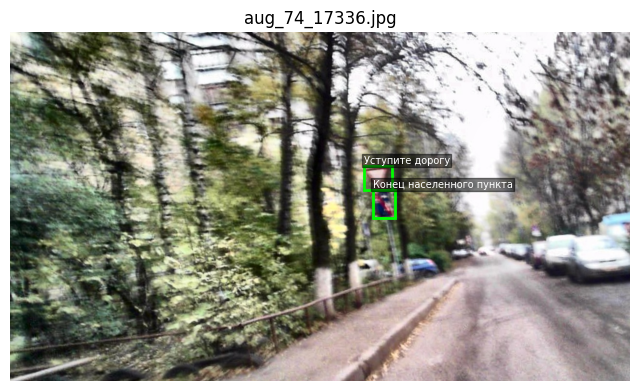

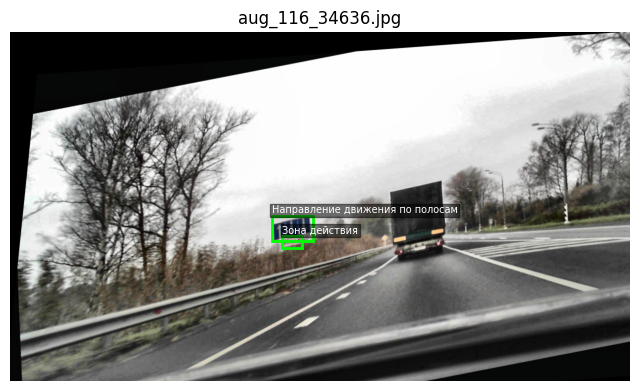

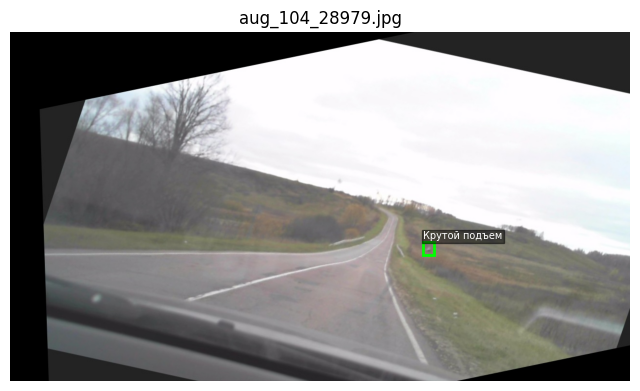

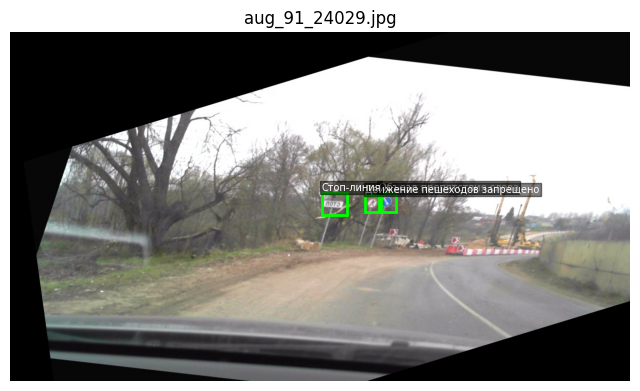

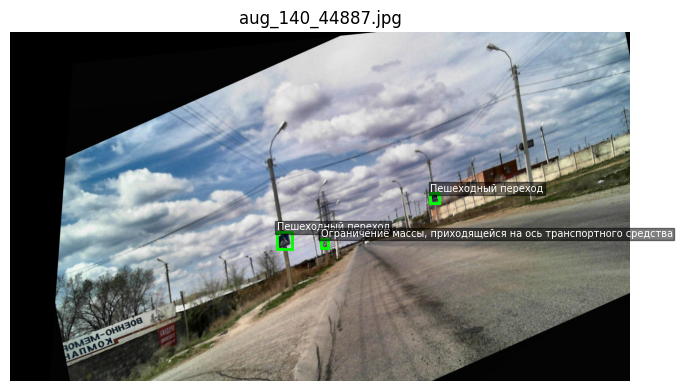

In [ ]:
visualize_yolo_augmented(
    image_dir="/content/extracted_content/YOLO_FORMAT/images/train",
    label_dir="/content/extracted_content/YOLO_FORMAT/labels/train",
    code_to_name=code_to_name,
    ordered_codes=list(code_to_name.keys()),
    num_samples=5,
    seed=SEED
)

Получили такой формат данных
     
      YOLO_FORMAT/
      ├── images/
      │   ├── train/   ← с аугментацией
      │   └── val/     ← без аугментации
      └── labels/
          ├── train/
          └── val/


In [ ]:
# Упорядоченный список индексов-кодов
ordered_codes = list(code_to_name.keys())

# Формируем список имён
index_to_name = [code_to_name[code] for code in ordered_codes]

# Формируем структуру YAML
data_yaml = {
    "train": "/content/extracted_content/YOLO_FORMAT/images/train",
    "val": "/content/extracted_content/YOLO_FORMAT/images/val",
    "nc": len(index_to_name),
    "names": index_to_name
}

# Сохраняем в файл
output_yaml_path = DATA_DIR / "YOLO_FORMAT/data.yaml"
with output_yaml_path.open("w", encoding="utf-8") as f:
    yaml.dump(data_yaml, f, allow_unicode=True)

print(f"Файл сохранён: {output_yaml_path.resolve()}")

Файл сохранён: C:\Users\Пользователь\Downloads\Russian traffic sign project\content\extracted_content\YOLO_FORMAT\data.yaml


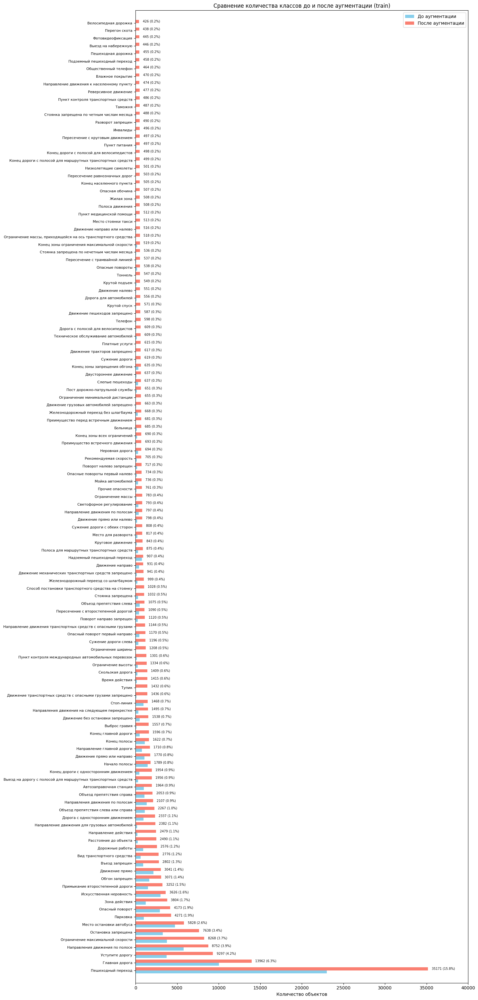

In [ ]:
# 1. Подсчёт ДО аугментации
for ann in train_annotations:
    if "category_name" not in ann:
        code = reverse_label_map.get(ann["category_id"], "Unknown")
        ann["category_name"] = code_to_name.get(code, code)
before_counter = Counter(ann["category_name"] for ann in train_annotations)

# 2. Подсчёт ПОСЛЕ аугментации
final_labels_dir = Path("/content/extracted_content/YOLO_FORMAT/labels/train")
after_counter = Counter()
for lbl in final_labels_dir.glob("*.txt"):
    with open(lbl, "r") as f:
        for line in f:
            cls_id = int(float(line.split()[0])) + 1
            code = reverse_label_map.get(cls_id, "Unknown")
            name = code_to_name.get(code, code)
            after_counter[name] += 1

# 3. Подготовка данных и сортировка
all_names = list(before_counter.keys() | after_counter.keys())
all_names.sort(key=lambda n: after_counter.get(n, 0), reverse=True)

before_vals = [before_counter.get(n, 0) for n in all_names]
after_vals  = [after_counter.get(n, 0)  for n in all_names]
total_after = sum(after_vals)

# 4. Рисуем график и аннотации
y = np.arange(len(all_names))
height = 0.4

plt.figure(figsize=(15, len(all_names) * 0.25))
bars_before = plt.barh(y - height/2, before_vals, height, label='До аугментации', color='skyblue')
bars_after  = plt.barh(y + height/2, after_vals,  height, label='После аугментации', color='salmon')

# Добавляем подписи "count (percent%)" после после-столбцов
for bar, count in zip(bars_after, after_vals):
    width = bar.get_width()
    percent = 100 * count / total_after if total_after > 0 else 0
    plt.text(width + total_after * 0.002,  # чуть правее столбца
             bar.get_y() + bar.get_height() / 2,
             f"{count} ({percent:.1f}%)",
             va='center', fontsize=7)

plt.yticks(y, all_names, fontsize=8)
plt.xlabel("Количество объектов")
plt.title("Сравнение количества классов до и после аугментации (train)")
plt.margins(y=0.01)
ax = plt.gca()
ax.set_xlim(0, 40000)
plt.legend()
plt.tight_layout()
plt.show()

Дисбаланс классов сохранился, но стало больше экземпляров редких классов, что даст модели больше данных для обучения. Почему сохранился дисбаланс? Потому что у нас на изображениях присутствует несколько дорожных знаков, следовательно при применении аугментации для редкого класса, мы автоматически применяем аугментации на все дорожные знаки, какие есть на изображении. Поэтому число знаков, например, "Пешеходного перехода" также выросло, хотя мы явно и не задавали аугментации для классов, число которых больше 500.

**Выведем все знаки, посмотрим, правильно ли мы их классифицировали.**

In [ ]:
DATA_DIR = Path("C:/Users/Пользователь/Downloads/Russian traffic sign project/content/extracted_content")
data_yaml_path = DATA_DIR / "YOLO_FORMAT/data.yaml"
output_dir = DATA_DIR / "output_crops"
max_per_class = 5

# Загрузка классов
with open(data_yaml_path, encoding='utf-8') as f:
    data = yaml.safe_load(f)

class_names = data['names']
nc = data['nc']
train_img_dir = Path(data['train'])
train_lbl_dir = train_img_dir.parent.parent / "labels" / "train"

# Контейнер для подсчета кропов
class_counter = defaultdict(int)
os.makedirs(output_dir, exist_ok=True)

# Проход по всем аннотациям
label_paths = list(train_lbl_dir.glob("*.txt"))

for label_path in tqdm(label_paths, desc="Processing annotations"):
    with open(label_path, "r") as f:
        lines = f.readlines()
    if not lines:
        continue

    # Поиск изображения
    img_stem = label_path.stem
    image_path = train_img_dir / f"{img_stem}.jpg"
    if not image_path.exists():
        image_path = train_img_dir / f"{img_stem}.png"
    if not image_path.exists():
        continue

    img = cv2.imread(str(image_path))
    if img is None:
        continue
    h, w = img.shape[:2]

    for i, line in enumerate(lines):
        parts = line.strip().split()
        if len(parts) != 5:
            continue

        cls_id, x_center, y_center, bw, bh = map(float, parts)
        cls_id = int(cls_id)

        if class_counter[cls_id] >= max_per_class:
            continue

        # YOLO формат -> пиксели
        xc, yc = int(x_center * w), int(y_center * h)
        bw, bh = int(bw * w), int(bh * h)
        x1 = max(xc - bw // 2, 0)
        y1 = max(yc - bh // 2, 0)
        x2 = min(xc + bw // 2, w)
        y2 = min(yc + bh // 2, h)

        crop = img[y1:y2, x1:x2]
        if crop.size == 0 or crop.shape[0] < 5 or crop.shape[1] < 5:
            continue

        class_name = class_names[cls_id].replace("/", "_").replace(" ", "_")
        class_folder = Path(output_dir) / f"{cls_id:03d}_{class_name}"
        class_folder.mkdir(parents=True, exist_ok=True)

        out_path = class_folder / f"{img_stem}_{i}.jpg"
        cv2.imwrite(str(out_path), crop)
        class_counter[cls_id] += 1

Processing annotations: 100%|██████████| 106410/106410 [06:32<00:00, 271.35it/s]


In [ ]:
# Подсчет всех объектов по классам
all_class_counts = defaultdict(int)

for label_path in tqdm(label_paths, desc="Counting total objects"):
    with open(label_path, "r") as f:
        lines = f.readlines()
    for line in lines:
        parts = line.strip().split()
        if len(parts) != 5:
            continue
        cls_id = int(float(parts[0]))
        all_class_counts[cls_id] += 1

# Визуализация
def show_class_crops(output_dir, class_names, all_class_counts, max_per_class=5):
    output_dir = Path(output_dir)
    sorted_folders = sorted(output_dir.glob("*"))

    for folder in sorted_folders:
        parts = folder.name.split("_", 1)
        if len(parts) != 2:
            continue
        cls_id = int(parts[0])
        class_title = class_names[cls_id]
        total_count = all_class_counts.get(cls_id, 0)

        image_paths = sorted(folder.glob("*.jpg"))[:max_per_class]
        if not image_paths:
            continue

        # Заголовок с количеством
        display(HTML(f"<h4>{class_title} <span style='color:gray'>({total_count} crops)</span></h4>"))

        # Отображение изображений
        fig, axs = plt.subplots(1, len(image_paths), figsize=(len(image_paths), 4))
        if len(image_paths) == 1:
            axs = [axs]
        for ax, img_path in zip(axs, image_paths):
            img = cv2.imread(str(img_path))
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            ax.imshow(img)
            ax.axis("off")
        plt.tight_layout()
        plt.show()

show_class_crops(output_dir, class_names,all_class_counts, max_per_class=5)

Есть несколько опечаток в названии некоторых знаков (данный кусочек кода я добавил после обучения модели, к сожалению, но опечаток не так много, поэтому на классификацию знаков не должно сильно повлиять).

## Обучение модели YOLO

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

### YOLO 11

In [ ]:
# Инициализация модели
model = YOLO('yolo11s.pt')

# Параметры обучения
results = model.train(
    data=DATA_DIR / 'YOLO_FORMAT/data.yaml',
    epochs=20,
    patience=3,  # Остановка при отсутствии улучшений
    batch=16,
    imgsz=640,
    device=0,  # Использовать GPU
    workers=0,  # Потоки загрузки данных
    optimizer='AdamW',  # Лучше для transfer learning
    lr0=0.0005,  # Learning rate
    lrf=0.1,  # Final LR = lr0 * lrf
    weight_decay=0.0005,
    amp=True,  # Mixed Precision (ускорение + экономия памяти)
    cache=True,  # Кеширование (требует RAM)
    single_cls=False,  # У нас 155 классов
    pretrained=True,  # Использовать предобученные веса
    plots=True,  # Генерация графиков
    project=DATA_DIR / "RTSD_YOLO11s",
    name='yolo11s',
    augment=True
)

100%|██████████| 18.4M/18.4M [00:33<00:00, 569kB/s] 


Ultralytics 8.3.163  Python-3.12.8 torch-2.7.1+cu128 CUDA:0 (NVIDIA GeForce RTX 3060, 12288MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=C:\Users\\Downloads\Russian traffic sign project\content\extracted_content\YOLO_FORMAT\data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=20, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.0005, lrf=0.1, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolo11s, nbs=64, nms=False, opset=None, optimize=False, optimizer=AdamW, ove

100%|██████████| 22.2M/22.2M [00:06<00:00, 3.46MB/s]

Overriding model.yaml nc=80 with nc=155

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  3                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  4                  -1  1    103360  ultralytics.nn.modules.block.C3k2            [128, 256, 1, False, 0.25]    
  5                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              


  6                  -1  1    346112  ultralytics.nn.modules.block.C3k2            [256, 256, 1, True]           
  7                  -1  1   1180672  ultralytics.nn.modules.conv.Conv             [256, 512, 3, 2]              
  8                  -1  1   1380352  ultralytics.nn.modules.block.C3k2            [512, 512, 1, True]           
  9                  -1  1    656896  ultralytics.nn.modules.block.SPPF            [512, 512, 5]                 
 10                  -1  1    990976  ultralytics.nn.modules.block.C2PSA           [512, 512, 1]                 
 11                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None, 2, 'nearest']          
 12             [-1, 6]  1         0  ultralytics.nn.modules.conv.Concat           [1]                           
 13                  -1  1    443776  ultralytics.nn.modules.block.C3k2            [768, 256, 1, False]          
 14                  -1  1         0  torch.nn.modules.upsampling.Upsample         [None

100%|██████████| 5.35M/5.35M [00:01<00:00, 4.54MB/s]


AMP: checks passed 
train: Fast image access  (ping: 0.00.0 ms, read: 38.516.0 MB/s, size: 137.4 KB)


train: Scanning C:\Users\Пользователь\Downloads\Russian traffic sign project\content\extracted_content\YOLO_FORMAT\labels\train... 106410 images, 0 backgrounds, 0 corrupt: 100%|██████████| 106410/106410 [01:08<00:00, 1564.44it/s]


train: New cache created: C:\Users\\Downloads\Russian traffic sign project\content\extracted_content\YOLO_FORMAT\labels\train.cache
WARNING train: 102.7GB RAM required to cache images with 50% safety margin but only 40.3/63.8GB available, not caching images
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access  (ping: 0.00.0 ms, read: 41.322.8 MB/s, size: 155.3 KB)


val: Scanning C:\Users\Пользователь\Downloads\Russian traffic sign project\content\extracted_content\YOLO_FORMAT\labels\val... 5000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5000/5000 [00:05<00:00, 870.46it/s]


val: New cache created: C:\Users\\Downloads\Russian traffic sign project\content\extracted_content\YOLO_FORMAT\labels\val.cache
WARNING cache='ram' may produce non-deterministic training results. Consider cache='disk' as a deterministic alternative if your disk space allows.


val: Caching images (3.2GB RAM): 100%|██████████| 5000/5000 [00:04<00:00, 1054.88it/s]


Plotting labels to C:\Users\\Downloads\Russian traffic sign project\content\extracted_content\RTSD_YOLO11s\yolo11s\labels.jpg... 
optimizer: AdamW(lr=0.0005, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Users\\Downloads\Russian traffic sign project\content\extracted_content\RTSD_YOLO11s\yolo11s
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      4.41G       1.45      13.02      1.133         63        640:   0%|          | 3/6651 [00:02<1:07:50,  1.63it/s]

100%|██████████| 755k/755k [00:00<00:00, 2.06MB/s]1.189         62        640:   0%|          | 6/6651 [00:03<51:04,  2.17it/s]  
       1/20      4.65G      1.498       2.19     0.9977         32        640: 100%|██████████| 6651/6651 [45:10<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:29<00:00,  5.35it/s]


                   all       5000       8866      0.475      0.391      0.401      0.278

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20       5.1G      1.365      1.384     0.9624         58        640: 100%|██████████| 6651/6651 [48:04<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:29<00:00,  5.27it/s]


                   all       5000       8866      0.574      0.542       0.59      0.424

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      5.14G      1.303      1.186     0.9482         48        640: 100%|██████████| 6651/6651 [45:13<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:30<00:00,  5.16it/s]

                   all       5000       8866      0.626      0.611      0.666      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      5.16G       1.24      1.051     0.9304         37        640: 100%|██████████| 6651/6651 [44:07<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:28<00:00,  5.58it/s]

                   all       5000       8866      0.637      0.722      0.728      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      5.22G      1.183     0.9536     0.9158         25        640: 100%|██████████| 6651/6651 [44:51<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:30<00:00,  5.16it/s]

                   all       5000       8866      0.689      0.699      0.744      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      5.26G      1.144     0.8938     0.9058         41        640: 100%|██████████| 6651/6651 [45:24<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:31<00:00,  4.98it/s]


                   all       5000       8866      0.701      0.731       0.77      0.567

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20       5.3G      1.104     0.8409     0.8953         46        640: 100%|██████████| 6651/6651 [45:19<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:29<00:00,  5.38it/s]

                   all       5000       8866      0.728       0.73      0.781      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      5.32G       1.08     0.8003     0.8901         27        640: 100%|██████████| 6651/6651 [43:29<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:26<00:00,  5.82it/s]

                   all       5000       8866      0.738      0.745       0.79      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      5.38G      1.058     0.7677     0.8845         49        640: 100%|██████████| 6651/6651 [43:01<00:00,  2.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:27<00:00,  5.77it/s]

                   all       5000       8866      0.761      0.743      0.796       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      5.42G       1.04     0.7399     0.8808         31        640: 100%|██████████| 6651/6651 [43:08<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:28<00:00,  5.60it/s]

                   all       5000       8866      0.771      0.737      0.804      0.594


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      5.46G      0.977     0.6701     0.8726         25        640: 100%|██████████| 6651/6651 [45:14<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:29<00:00,  5.41it/s]


                   all       5000       8866      0.768      0.748      0.808      0.599

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      5.48G     0.9547     0.6412     0.8665         19        640: 100%|██████████| 6651/6651 [45:05<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:28<00:00,  5.45it/s]

                   all       5000       8866      0.773      0.745      0.815      0.604



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      5.54G     0.9379     0.6195     0.8637         25        640: 100%|██████████| 6651/6651 [43:38<00:00,  2.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:29<00:00,  5.31it/s]


                   all       5000       8866      0.798      0.742      0.824      0.613

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      5.59G     0.9231     0.6005     0.8589         15        640: 100%|██████████| 6651/6651 [44:05<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:27<00:00,  5.62it/s]

                   all       5000       8866      0.774      0.761      0.828      0.617



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      5.62G     0.9079     0.5839     0.8564         23        640: 100%|██████████| 6651/6651 [44:45<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:30<00:00,  5.12it/s]

                   all       5000       8866      0.781      0.764      0.834      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      5.64G      0.894     0.5675     0.8525         28        640: 100%|██████████| 6651/6651 [44:13<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:27<00:00,  5.69it/s]

                   all       5000       8866       0.76      0.785      0.841      0.632



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20       5.7G     0.8839     0.5546     0.8511         25        640: 100%|██████████| 6651/6651 [44:11<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:28<00:00,  5.56it/s]

                   all       5000       8866      0.776      0.794      0.846      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      5.75G     0.8691     0.5409     0.8475         16        640: 100%|██████████| 6651/6651 [44:14<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:29<00:00,  5.39it/s]

                   all       5000       8866      0.787       0.79       0.85      0.636



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      5.78G     0.8585     0.5288     0.8466         21        640: 100%|██████████| 6651/6651 [44:16<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:27<00:00,  5.74it/s]

                   all       5000       8866        0.8      0.789      0.855      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20       5.8G      0.846     0.5169     0.8433         23        640: 100%|██████████| 6651/6651 [44:18<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:29<00:00,  5.30it/s]

                   all       5000       8866      0.808      0.787      0.862      0.647



20 epochs completed in 15.029 hours.
Optimizer stripped from C:\Users\\Downloads\Russian traffic sign project\content\extracted_content\RTSD_YOLO11s\yolo11s\weights\last.pt, 19.3MB
Optimizer stripped from C:\Users\\Downloads\Russian traffic sign project\content\extracted_content\RTSD_YOLO11s\yolo11s\weights\best.pt, 19.3MB

Validating C:\Users\\Downloads\Russian traffic sign project\content\extracted_content\RTSD_YOLO11s\yolo11s\weights\best.pt...
Ultralytics 8.3.163  Python-3.12.8 torch-2.7.1+cu128 CUDA:0 (NVIDIA GeForce RTX 3060, 12288MiB)
YOLO11s summary (fused): 100 layers, 9,472,785 parameters, 0 gradients, 21.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:42<00:00,  3.69it/s]


                   all       5000       8866      0.795      0.778      0.857      0.626
                 929        934      0.918      0.955      0.981      0.741
                225        229       0.87      0.876      0.948      0.673
         103        107      0.863      0.763       0.88      0.636
          319        343      0.893      0.899      0.931      0.687
                   74         74      0.779      0.715      0.809      0.598
         148        154      0.948      0.825      0.915      0.655
            1311       2117       0.87      0.921      0.956      0.675
          424        445      0.897      0.935      0.958      0.651
             10         10      0.866      0.652      0.915       0.68
            -         97         97      0.829      0.797      0.862      0.608
               3          3          1      0.961      0.995      0.881
             47         47      0.908       0.84      0.895      0.691
                335        340      0.912  

### YOLO 12

In [ ]:
# Инициализация модели
model = YOLO('yolo12s.pt')

# Параметры обучения
results = model.train(
    data=DATA_DIR / 'YOLO_FORMAT/data.yaml',
    epochs=30,
    patience=3,  # Остановка при отсутствии улучшений
    batch=16,
    imgsz=640,
    device=0,  # Использовать GPU
    workers=0,  # Потоки загрузки данных
    optimizer='AdamW',  # Лучше для transfer learning
    lr0=0.0005,  # Learning rate
    lrf=0.1,  # Final LR = lr0 * lrf
    weight_decay=0.0005,
    amp=True,  # Mixed Precision (ускорение + экономия памяти)
    cache=True,  # Кеширование (требует RAM)
    single_cls=False,  # У нас 155 классов
    pretrained=True,  # Использовать предобученные веса
    plots=True,  # Генерация графиков
    project=DATA_DIR / "RTSD_YOLO12s",
    name='yolo12s',
    augment=True
)

New https://pypi.org/project/ultralytics/8.3.165 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.163  Python-3.12.8 torch-2.7.1+cu128 CUDA:0 (NVIDIA GeForce RTX 3060, 12288MiB)
engine\trainer: agnostic_nms=False, amp=True, augment=True, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=True, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=C:\Users\\Downloads\Russian traffic sign project\content\extracted_content\YOLO_FORMAT\data.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.0005, lrf=0.1, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo12s.pt, momentum=0.937, mosaic=1.0,

train: Scanning C:\Users\Пользователь\Downloads\Russian traffic sign project\content\extracted_content\YOLO_FORMAT\labels\train.cache... 106410 images, 0 backgrounds, 0 corrupt: 100%|██████████| 106410/106410 [00:00<?, ?it/s]


WARNING train: 102.7GB RAM required to cache images with 50% safety margin but only 46.0/63.8GB available, not caching images
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access  (ping: 0.00.0 ms, read: 1618.8942.8 MB/s, size: 155.3 KB)


val: Scanning C:\Users\Пользователь\Downloads\Russian traffic sign project\content\extracted_content\YOLO_FORMAT\labels\val.cache... 5000 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5000/5000 [00:00<?, ?it/s]

WARNING cache='ram' may produce non-deterministic training results. Consider cache='disk' as a deterministic alternative if your disk space allows.



val: Caching images (3.2GB RAM): 100%|██████████| 5000/5000 [00:03<00:00, 1427.29it/s]


Plotting labels to C:\Users\\Downloads\Russian traffic sign project\content\extracted_content\RTSD_YOLO12s\yolo12s\labels.jpg... 
optimizer: AdamW(lr=0.0005, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0005), 119 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Users\\Downloads\Russian traffic sign project\content\extracted_content\RTSD_YOLO12s\yolo12s
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30      6.31G      1.515      2.159       1.01         32        640: 100%|██████████| 6651/6651 [58:45<00:00,  1.89it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:32<00:00,  4.87it/s]


                   all       5000       8866      0.512      0.408      0.395      0.269

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30      6.24G      1.397       1.43     0.9784         58        640: 100%|██████████| 6651/6651 [59:26<00:00,  1.86it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:32<00:00,  4.91it/s]


                   all       5000       8866      0.618      0.508      0.572      0.408

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30       6.3G      1.334      1.235     0.9626         48        640: 100%|██████████| 6651/6651 [58:53<00:00,  1.88it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:32<00:00,  4.80it/s]


                   all       5000       8866      0.606      0.639      0.661      0.472

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30       6.4G      1.263      1.088     0.9424         37        640: 100%|██████████| 6651/6651 [57:47<00:00,  1.92it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:34<00:00,  4.61it/s]


                   all       5000       8866      0.689      0.645      0.711      0.514

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30      6.28G      1.205     0.9847     0.9269         25        640: 100%|██████████| 6651/6651 [58:29<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:34<00:00,  4.61it/s]


                   all       5000       8866      0.675      0.685      0.737      0.535

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30      6.37G      1.167     0.9198     0.9164         41        640: 100%|██████████| 6651/6651 [56:48<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:30<00:00,  5.20it/s]


                   all       5000       8866      0.714      0.702      0.773      0.564

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30      6.41G      1.127     0.8614     0.9059         46        640: 100%|██████████| 6651/6651 [57:46<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:30<00:00,  5.09it/s]


                   all       5000       8866      0.746      0.709      0.786      0.577

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30      6.26G      1.097     0.8195     0.8989         27        640: 100%|██████████| 6651/6651 [57:17<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:32<00:00,  4.83it/s]


                   all       5000       8866       0.76      0.713      0.796      0.585

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30      6.42G      1.071      0.783     0.8927         49        640: 100%|██████████| 6651/6651 [57:33<00:00,  1.93it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:30<00:00,  5.12it/s]

                   all       5000       8866       0.76      0.725      0.807      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30      6.38G      1.053     0.7542     0.8888         31        640: 100%|██████████| 6651/6651 [57:52<00:00,  1.92it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:31<00:00,  5.03it/s]

                   all       5000       8866      0.763      0.744      0.816      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30      6.41G      1.032     0.7274     0.8837         49        640: 100%|██████████| 6651/6651 [57:53<00:00,  1.91it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:31<00:00,  4.93it/s]

                   all       5000       8866      0.767      0.752      0.826       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30      6.39G      1.016     0.7064       0.88         45        640: 100%|██████████| 6651/6651 [57:50<00:00,  1.92it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:35<00:00,  4.47it/s]

                   all       5000       8866      0.771      0.762      0.831      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30      6.42G          1     0.6854     0.8779         46        640: 100%|██████████| 6651/6651 [58:10<00:00,  1.91it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:30<00:00,  5.15it/s]


                   all       5000       8866      0.779      0.766      0.839       0.62

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30      6.39G     0.9873     0.6668      0.874         36        640: 100%|██████████| 6651/6651 [56:49<00:00,  1.95it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:33<00:00,  4.66it/s]


                   all       5000       8866      0.786      0.773      0.844      0.626

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30      6.41G     0.9724     0.6496     0.8709         34        640: 100%|██████████| 6651/6651 [56:43<00:00,  1.95it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:31<00:00,  4.94it/s]


                   all       5000       8866      0.793      0.772      0.849      0.631

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30      6.39G     0.9635     0.6367     0.8693         46        640: 100%|██████████| 6651/6651 [56:39<00:00,  1.96it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:31<00:00,  5.02it/s]


                   all       5000       8866      0.805      0.772      0.855      0.635

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30      6.42G     0.9522     0.6203      0.867         32        640: 100%|██████████| 6651/6651 [56:20<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:31<00:00,  5.02it/s]


                   all       5000       8866      0.816      0.774       0.86       0.64

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30      6.24G     0.9389     0.6063     0.8638         31        640: 100%|██████████| 6651/6651 [57:33<00:00,  1.93it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:31<00:00,  4.98it/s]

                   all       5000       8866       0.82       0.78      0.864      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30      6.41G     0.9309      0.596     0.8628         34        640: 100%|██████████| 6651/6651 [56:23<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:31<00:00,  4.99it/s]

                   all       5000       8866      0.832       0.78       0.87      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30      6.25G     0.9194     0.5844     0.8599         48        640: 100%|██████████| 6651/6651 [57:27<00:00,  1.93it/s] 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:29<00:00,  5.23it/s]

                   all       5000       8866      0.843      0.775      0.872      0.647


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30      6.24G     0.8741     0.5315     0.8534         17        640: 100%|██████████| 6651/6651 [54:31<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:32<00:00,  4.86it/s]

                   all       5000       8866      0.847      0.783      0.878      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30      6.37G     0.8591      0.518     0.8506         23        640: 100%|██████████| 6651/6651 [55:28<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:31<00:00,  4.92it/s]

                   all       5000       8866      0.858      0.783      0.883      0.659



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30      6.41G      0.846     0.5052     0.8471         24        640: 100%|██████████| 6651/6651 [54:48<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:30<00:00,  5.09it/s]

                   all       5000       8866      0.861      0.788      0.886      0.663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30      6.39G     0.8369      0.497     0.8456         25        640: 100%|██████████| 6651/6651 [54:57<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:30<00:00,  5.17it/s]

                   all       5000       8866      0.847      0.808      0.886      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30       6.4G     0.8279      0.488     0.8442         19        640: 100%|██████████| 6651/6651 [54:41<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:33<00:00,  4.73it/s]

                   all       5000       8866      0.858      0.804      0.887      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30      6.38G     0.8165     0.4795     0.8418         17        640: 100%|██████████| 6651/6651 [55:05<00:00,  2.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:32<00:00,  4.79it/s]

                   all       5000       8866      0.876      0.797      0.889      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30      6.41G     0.8089     0.4703     0.8395         22        640: 100%|██████████| 6651/6651 [54:37<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:31<00:00,  4.98it/s]

                   all       5000       8866      0.888      0.794      0.893       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30      6.24G     0.7994     0.4629     0.8391         16        640: 100%|██████████| 6651/6651 [55:49<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:30<00:00,  5.15it/s]

                   all       5000       8866      0.878      0.801      0.895      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30      6.26G     0.7907     0.4558     0.8369         19        640: 100%|██████████| 6651/6651 [55:47<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:33<00:00,  4.68it/s]

                   all       5000       8866      0.876      0.808      0.898      0.675



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30      6.38G     0.7831     0.4495     0.8357         22        640: 100%|██████████| 6651/6651 [53:53<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:31<00:00,  4.92it/s]

                   all       5000       8866      0.875      0.811      0.899      0.676



30 epochs completed in 28.645 hours.
Optimizer stripped from C:\Users\\Downloads\Russian traffic sign project\content\extracted_content\RTSD_YOLO12s\yolo12s\weights\last.pt, 19.1MB
Optimizer stripped from C:\Users\\Downloads\Russian traffic sign project\content\extracted_content\RTSD_YOLO12s\yolo12s\weights\best.pt, 19.1MB

Validating C:\Users\\Downloads\Russian traffic sign project\content\extracted_content\RTSD_YOLO12s\yolo12s\weights\best.pt...
Ultralytics 8.3.163  Python-3.12.8 torch-2.7.1+cu128 CUDA:0 (NVIDIA GeForce RTX 3060, 12288MiB)
YOLOv12s summary (fused): 159 layers, 9,290,865 parameters, 0 gradients, 21.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 157/157 [00:50<00:00,  3.10it/s]


                   all       5000       8866      0.877      0.819      0.902      0.671
                 929        934       0.95      0.948      0.984      0.756
                225        229      0.927      0.884      0.965      0.713
         103        107      0.964       0.72      0.917      0.657
          319        343      0.912       0.91      0.947      0.701
                   74         74      0.818      0.728      0.859      0.654
         148        154      0.976      0.797      0.934      0.672
            1311       2117      0.905      0.902       0.96      0.696
          424        445      0.939       0.87      0.959      0.673
             10         10      0.846        0.9      0.958      0.708
            -         97         97      0.908       0.81      0.888      0.624
               3          3      0.929          1      0.995      0.842
             47         47      0.953      0.862      0.899      0.719
                335        340      0.953  

## Результаты обучения модели YOLO

**В результате обучения создается папка с сохраненными весами, логами, параметрами обучения и графиками.**

### для YOLO 11

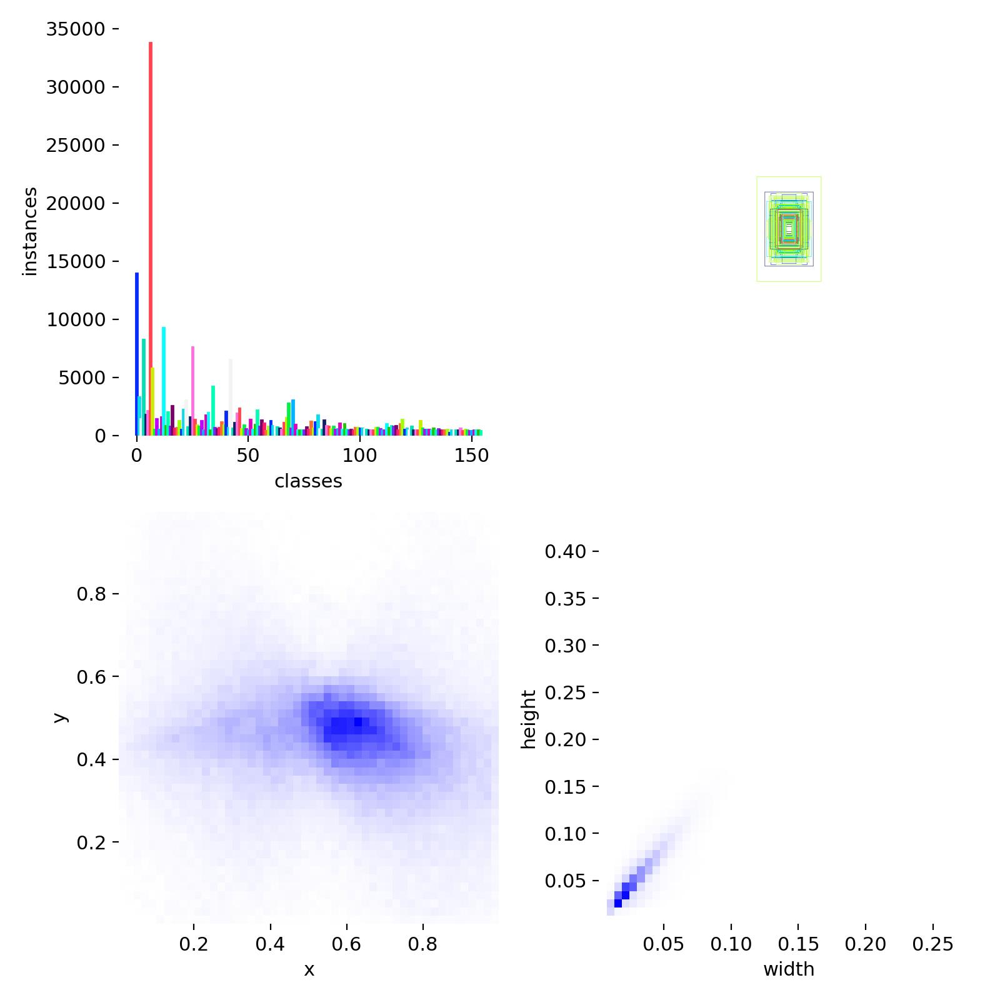

In [ ]:
display.Image('RTSD_YOLO11s/yolo11s/labels.jpg', width=900, height=600)

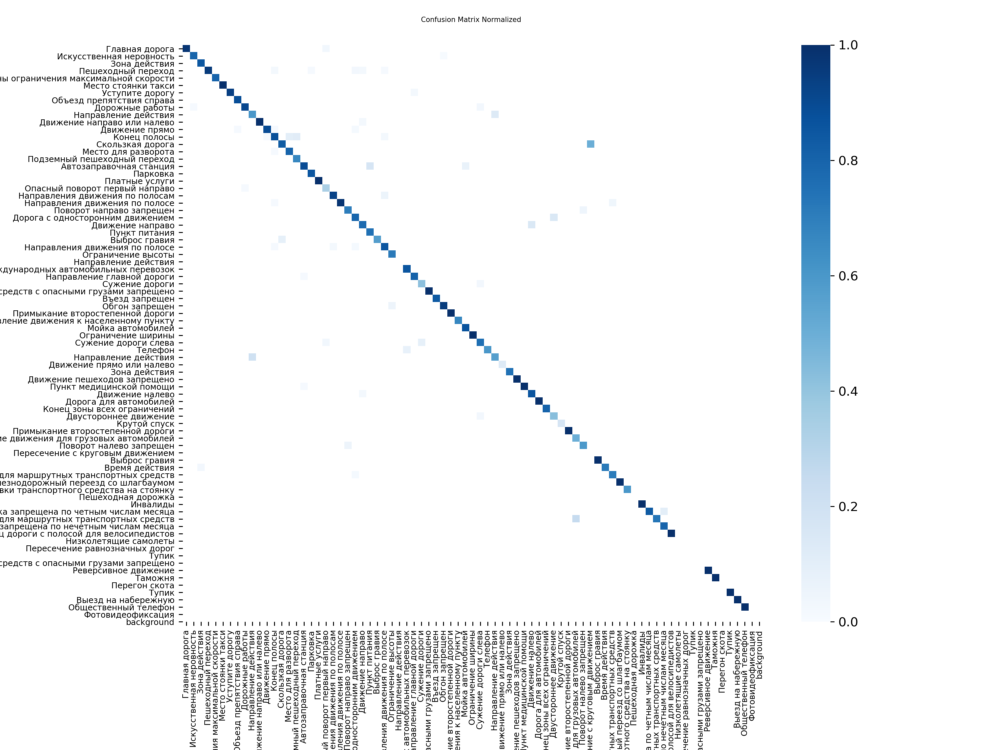

In [ ]:
display.Image('RTSD_YOLO11s/yolo11s/confusion_matrix_normalized.png', width=1200, height=900)

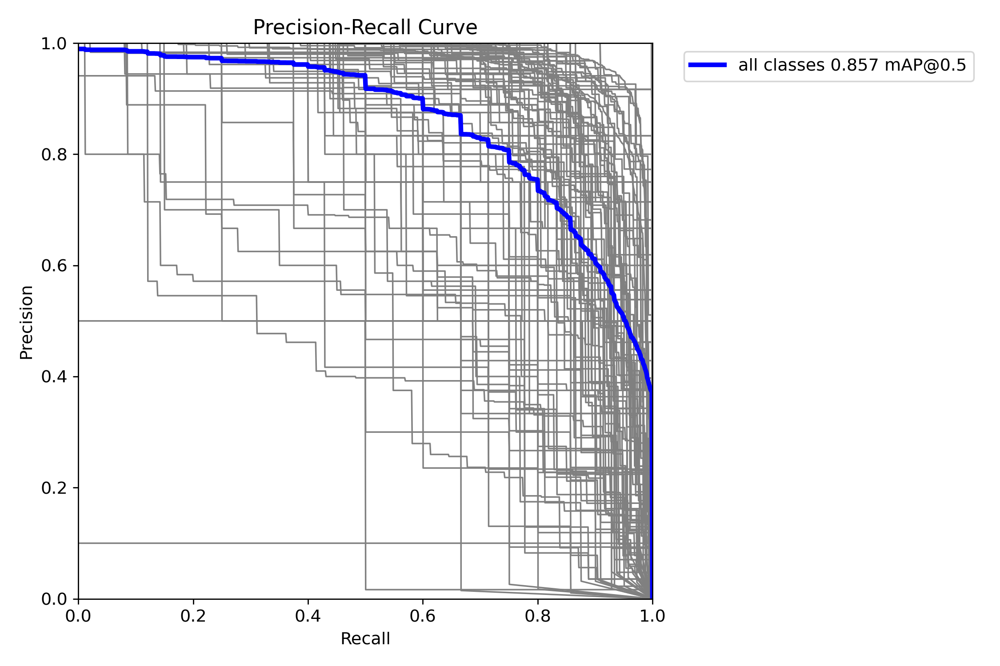

In [ ]:
display.Image('RTSD_YOLO11s/yolo11s/BoxPR_curve.png', width=900, height=600)

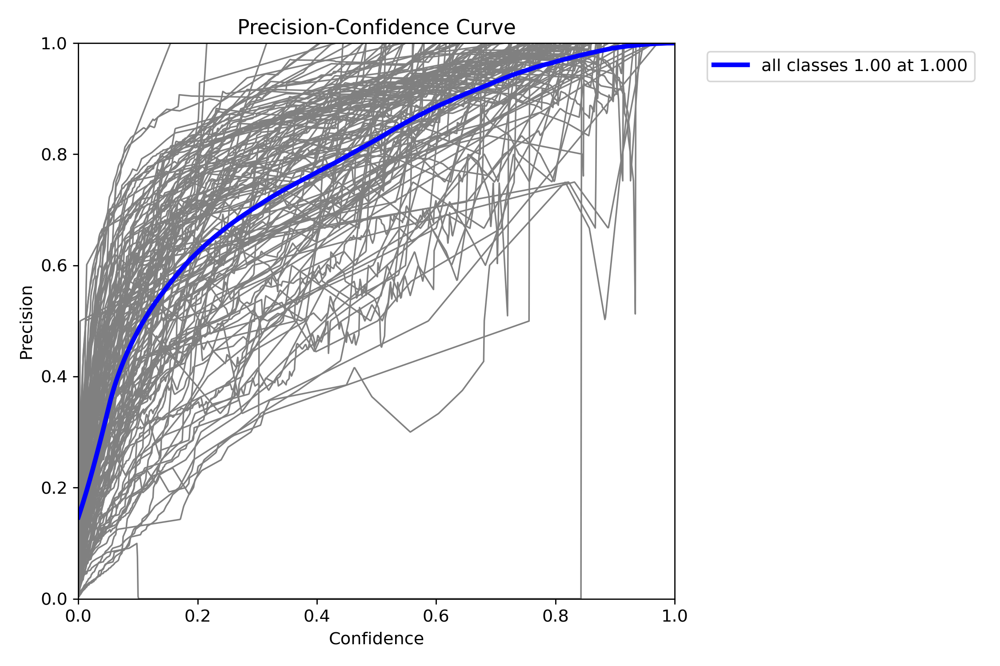

In [ ]:
display.Image('RTSD_YOLO11s/yolo11s/BoxP_curve.png', width=900, height=600)

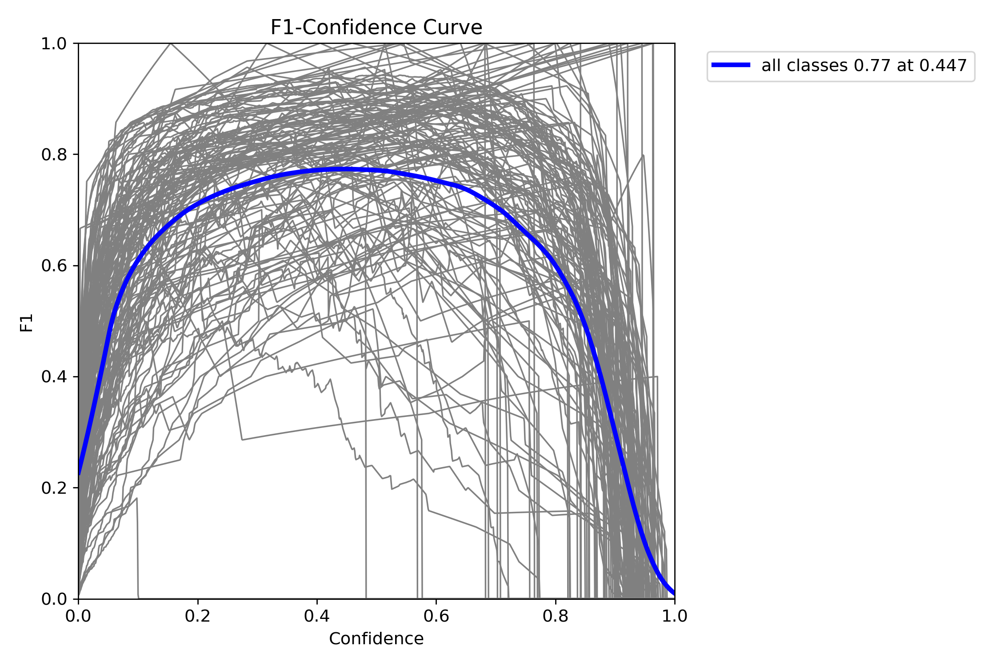

In [ ]:
display.Image('RTSD_YOLO11s/yolo11s/BoxF1_curve.png', width=900, height=600)

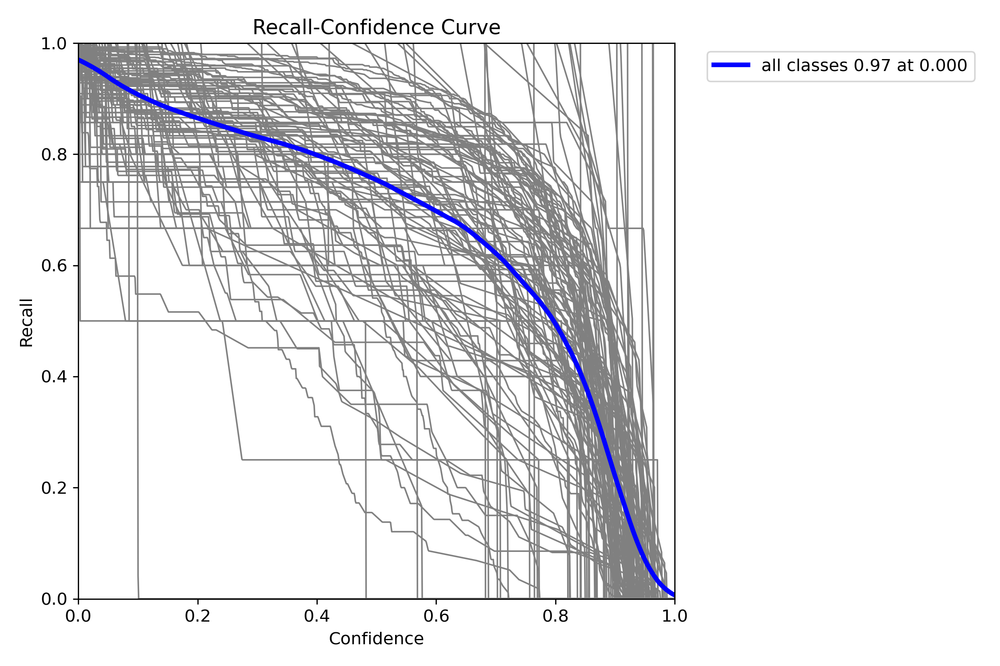

In [ ]:
display.Image('RTSD_YOLO11s/yolo11s/BoxR_curve.png', width=900, height=600)

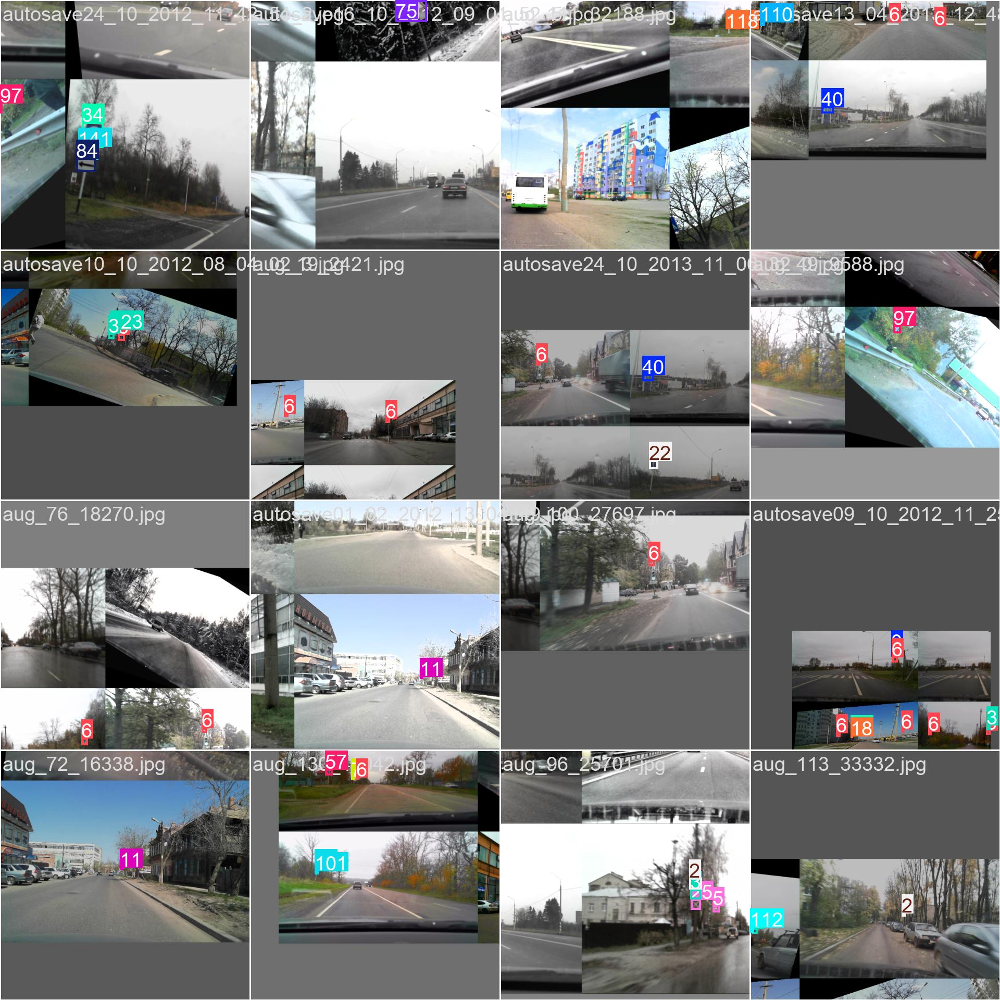

In [ ]:
display.Image('RTSD_YOLO11s/yolo11s/train_batch1.jpg', width=1280, height=720)

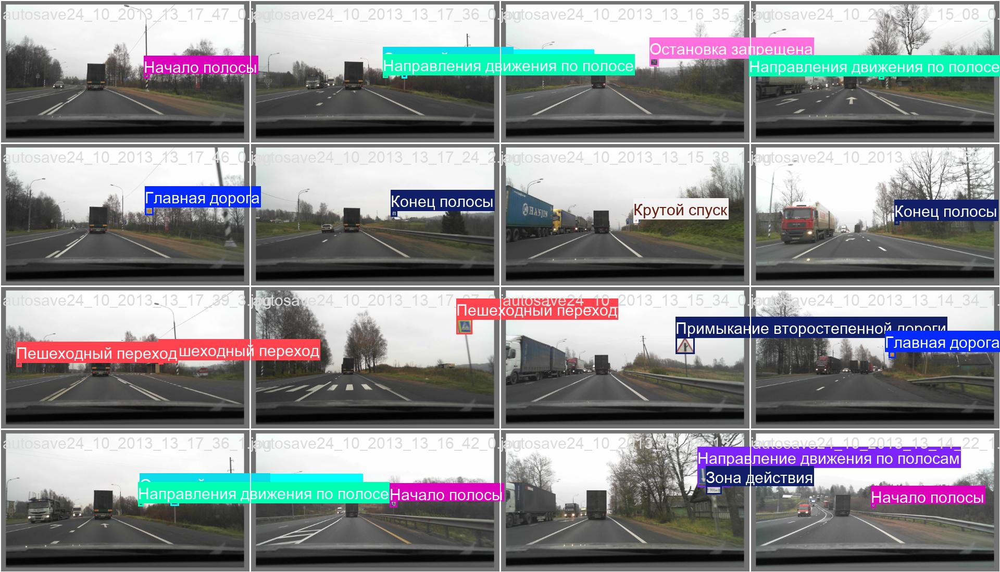

In [ ]:
display.Image('RTSD_YOLO11s/yolo11s/val_batch0_labels.jpg', width=1280, height=720)# True

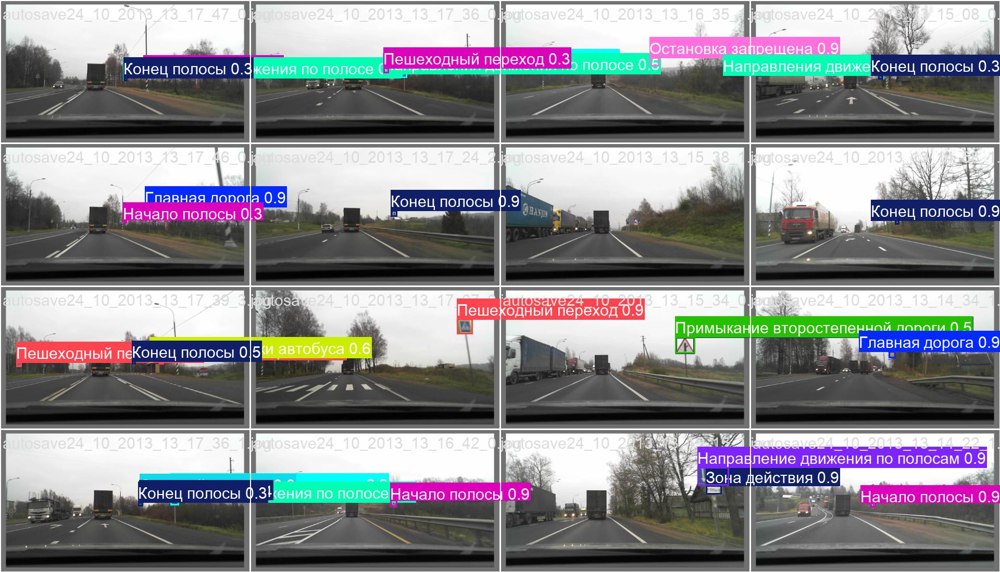

In [ ]:
display.Image('RTSD_YOLO11s/yolo11s/val_batch0_pred.jpg', width=1280, height=720) # Predicted

In [ ]:
df_results = pd.read_csv('RTSD_YOLO11s/yolo11s/results.csv')
df_results

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,2740.43,1.49756,2.19024,0.99773,0.47528,0.39086,0.40130,0.27836,1.05136,1.03010,0.85168,0.066838,0.000167,0.000167
1,2,5655.15,1.36548,1.38394,0.96236,0.57449,0.54224,0.59015,0.42359,0.98554,0.76827,0.83734,0.033657,0.000318,0.000318
2,3,8400.07,1.30316,1.18578,0.94819,0.62641,0.61148,0.66629,0.48289,0.94165,0.67474,0.83031,0.000460,0.000455,0.000455
3,4,11076.00,1.24001,1.05104,0.93041,0.63699,0.72247,0.72766,0.52717,0.92257,0.62437,0.82711,0.000432,0.000432,0.000432
4,5,13798.90,1.18323,0.95360,0.91580,0.68942,0.69871,0.74381,0.54431,0.90711,0.59411,0.82459,0.000410,0.000410,0.000410
5,6,16555.60,1.14362,0.89377,0.90584,0.70087,0.73087,0.76956,0.56748,0.90172,0.57528,0.82352,0.000387,0.000387,0.000387
6,7,19304.60,1.10393,0.84092,0.89533,0.72773,0.73030,0.78093,0.57860,0.89301,0.56202,0.82232,0.000365,0.000365,0.000365
7,8,21941.70,1.08034,0.80035,0.89010,0.73778,0.74451,0.79011,0.58451,0.88768,0.55325,0.82146,0.000342,0.000342,0.000342
8,9,24550.80,1.05757,0.76775,0.88448,0.76073,0.74288,0.79630,0.59034,0.88446,0.54621,0.82102,0.000320,0.000320,0.000320
9,10,27168.20,1.03965,0.73991,0.88078,0.77135,0.73670,0.80384,0.59407,0.88196,0.54012,0.82052,0.000298,0.000298,0.000298


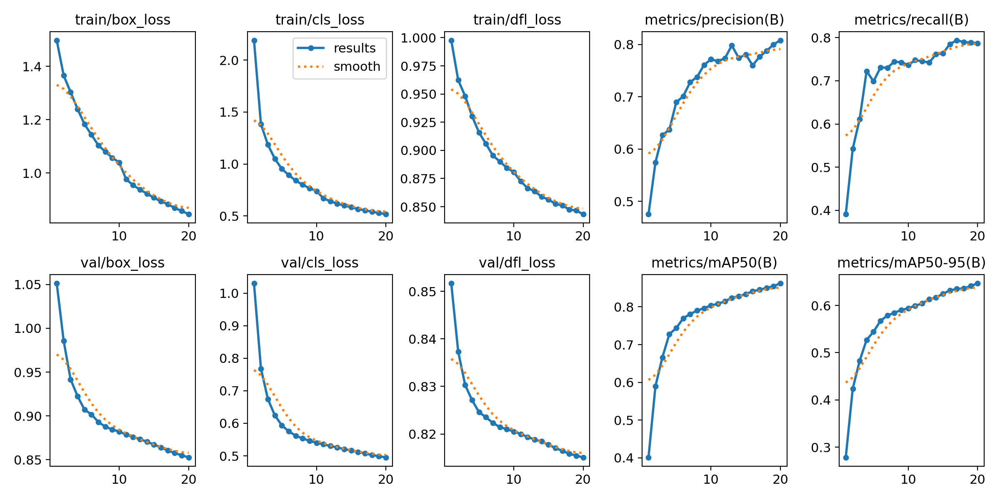

In [ ]:
display.Image('RTSD_YOLO11s/yolo11s/results.png', width=1200, height=600)

### для YOLO 12

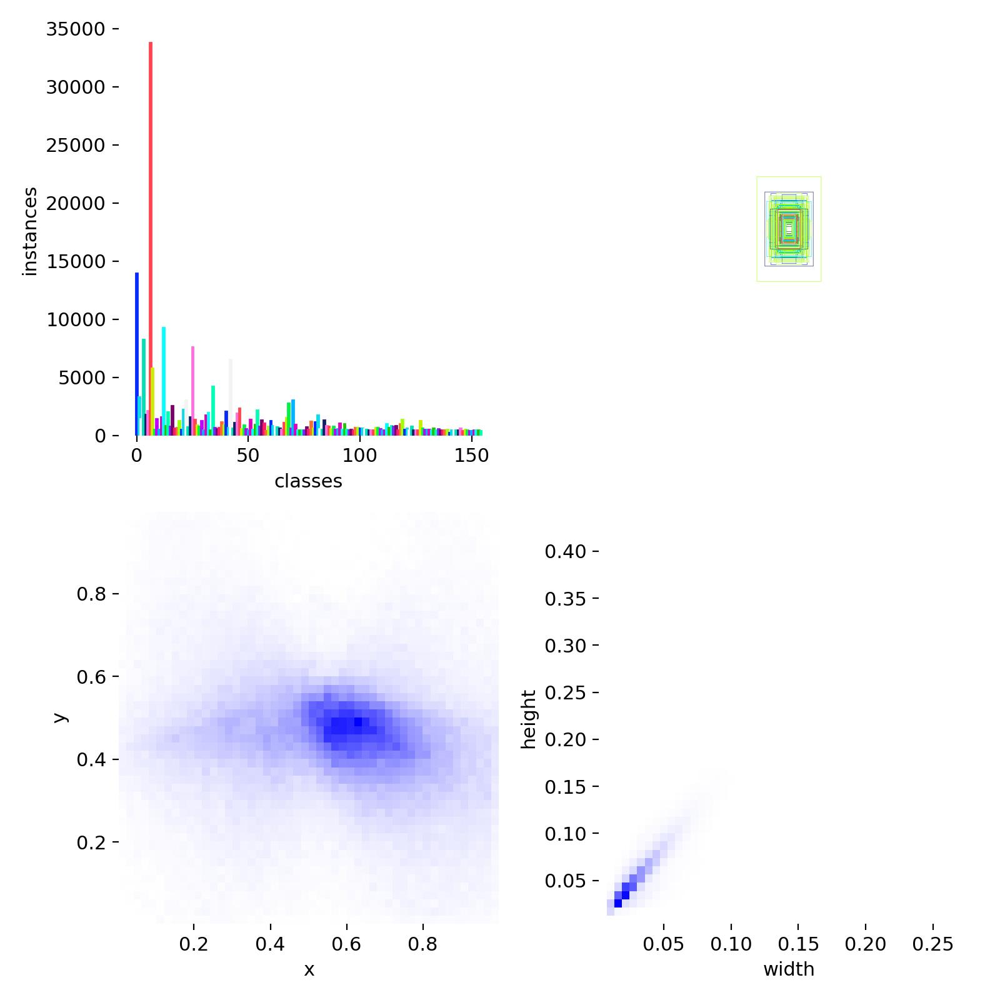

In [ ]:
display.Image('RTSD_YOLO12s/yolo12s/labels.jpg', width=900, height=600)

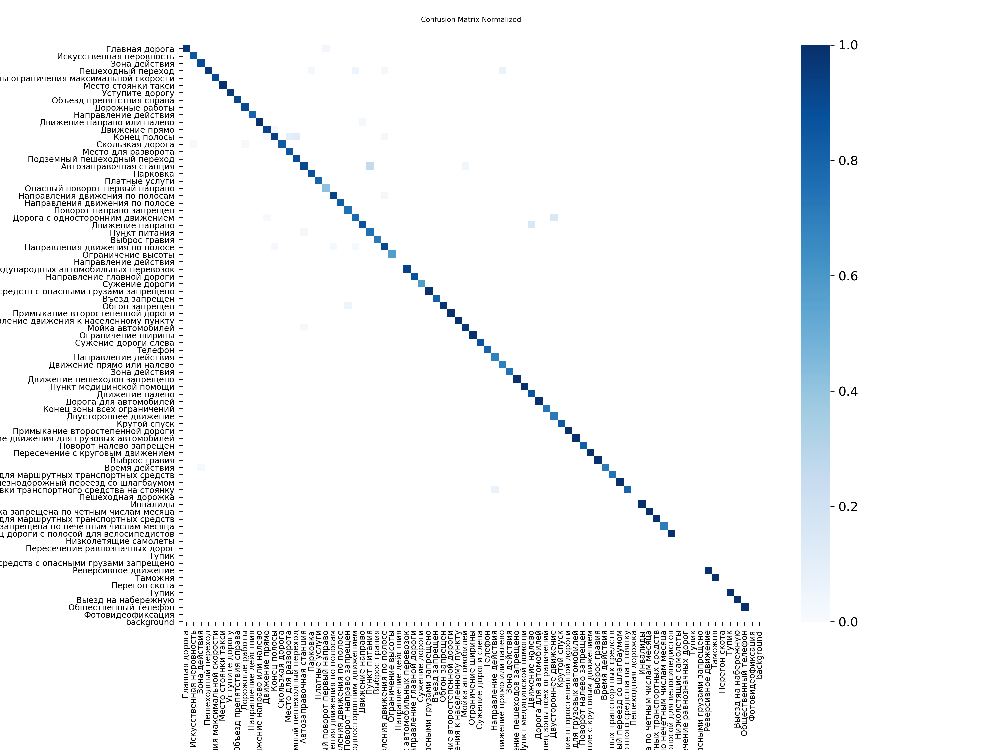

In [ ]:
display.Image('RTSD_YOLO12s/yolo12s/confusion_matrix_normalized.png', width=1200, height=900)

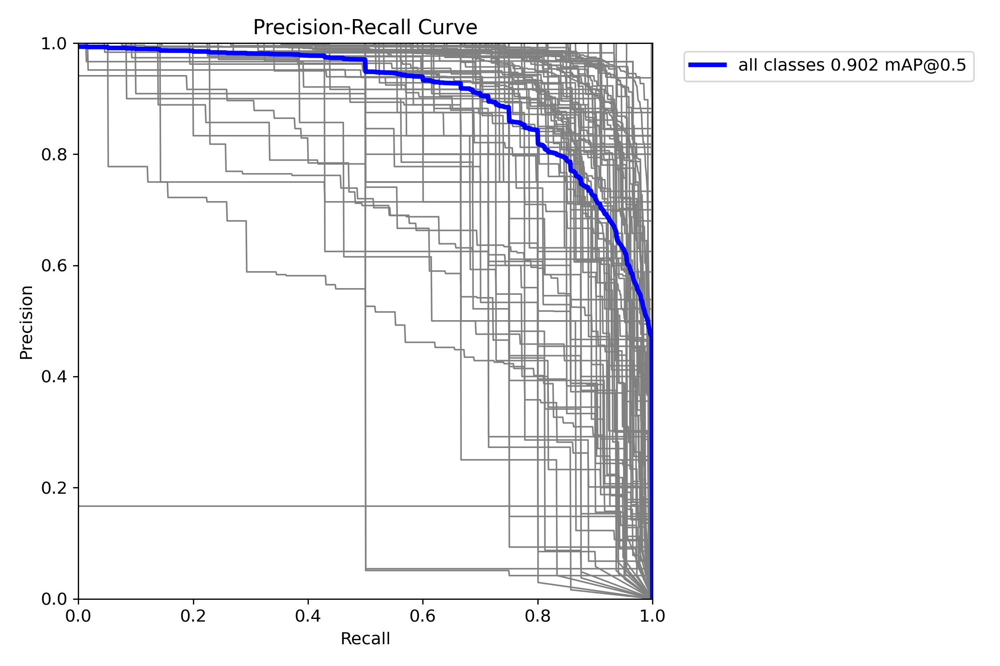

In [ ]:
display.Image('RTSD_YOLO12s/yolo12s/BoxPR_curve.png', width=900, height=600)

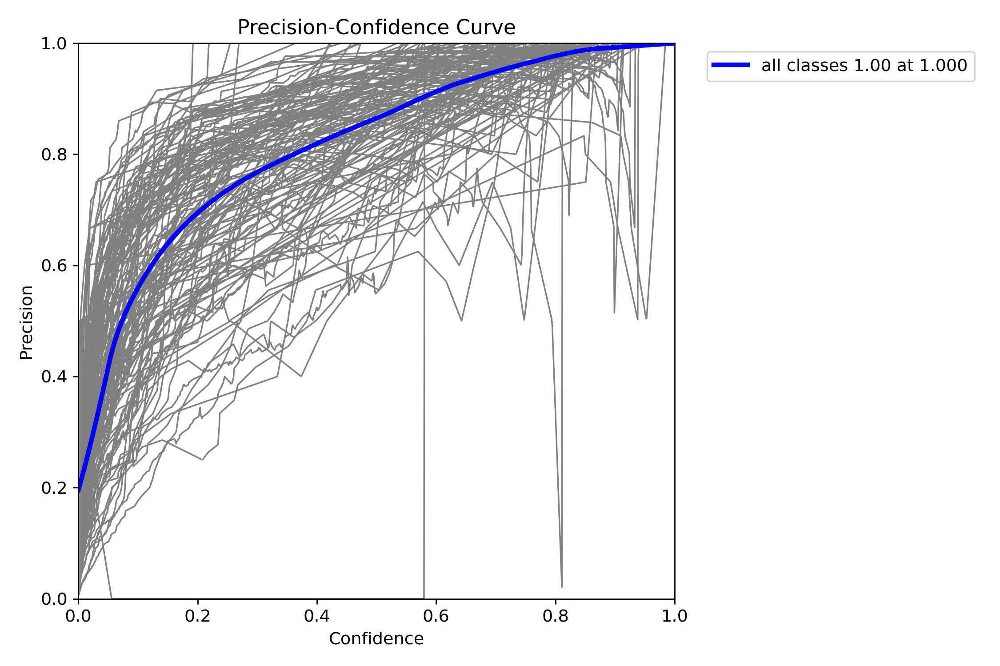

In [ ]:
display.Image('RTSD_YOLO12s/yolo12s/BoxP_curve.png', width=900, height=600)

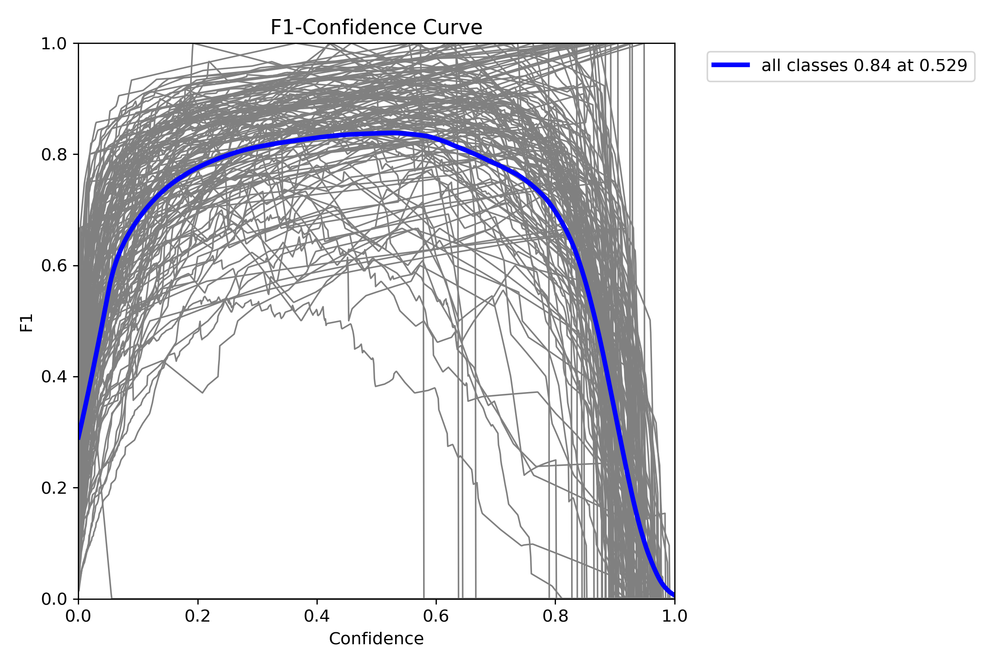

In [ ]:
display.Image('RTSD_YOLO12s/yolo12s/BoxF1_curve.png', width=900, height=600)

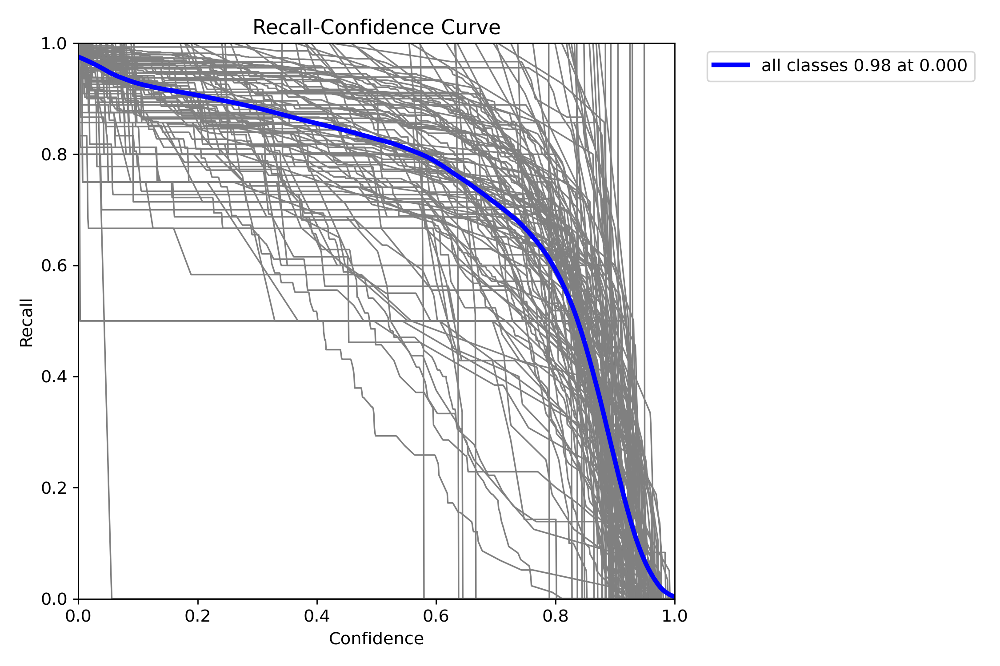

In [ ]:
display.Image('RTSD_YOLO12s/yolo12s/BoxR_curve.png', width=900, height=600)

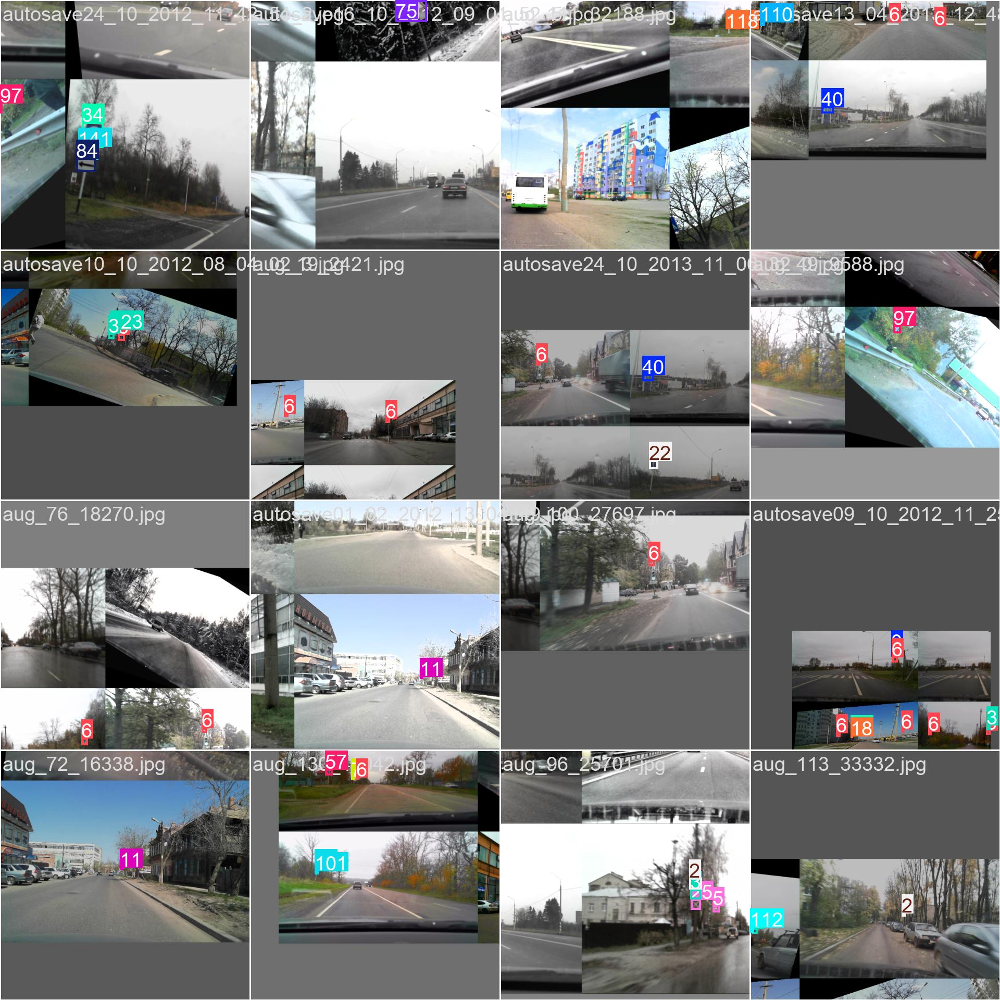

In [ ]:
display.Image('RTSD_YOLO12s/yolo12s/train_batch1.jpg', width=1280, height=720)

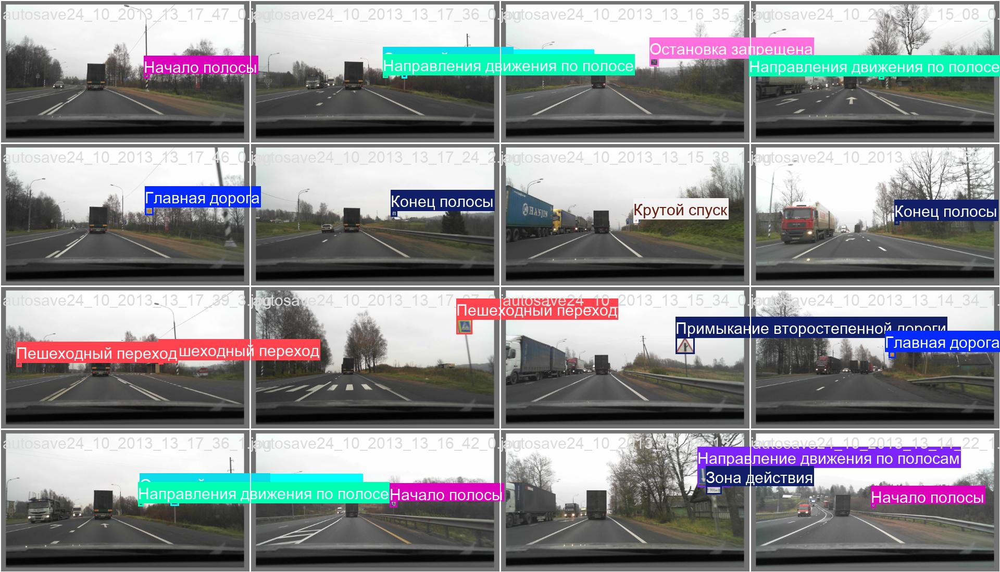

In [ ]:
display.Image('RTSD_YOLO12s/yolo12s/val_batch0_labels.jpg', width=1280, height=720)# True

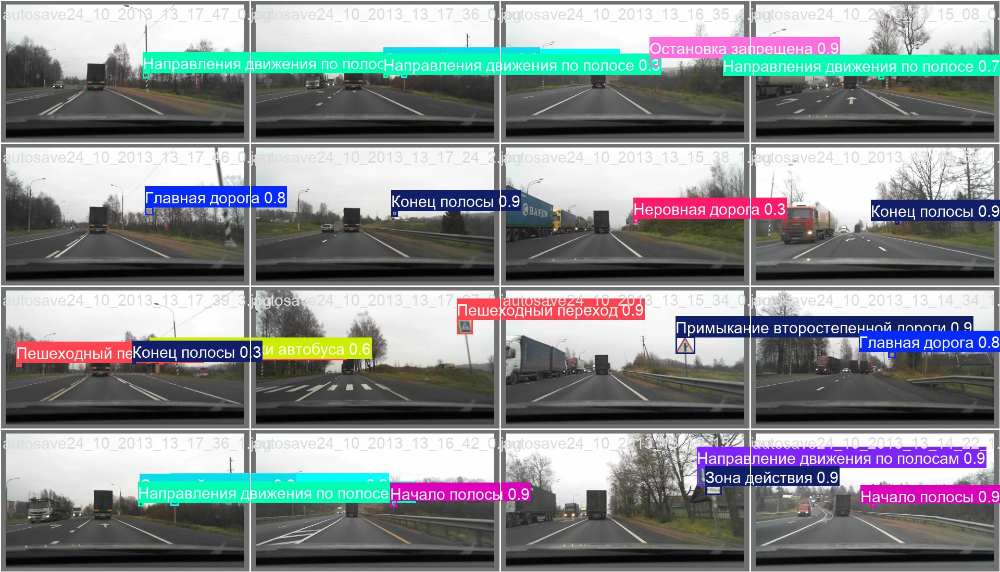

In [ ]:
display.Image('RTSD_YOLO12s/yolo12s/val_batch0_pred.jpg', width=1280, height=720) # Predicted

In [ ]:
df_results = pd.read_csv('RTSD_YOLO12s/yolo12s/results.csv')
df_results

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,3558.83,1.51453,2.15908,1.00980,0.51160,0.40766,0.39517,0.26903,1.07637,1.03498,0.85557,0.066838,0.000167,0.000167
1,2,7158.67,1.39684,1.42953,0.97837,0.61797,0.50753,0.57180,0.40834,0.98987,0.79282,0.84201,0.033662,0.000323,0.000323
2,3,10725.70,1.33396,1.23459,0.96257,0.60635,0.63904,0.66052,0.47216,0.95184,0.69897,0.83453,0.000475,0.000470,0.000470
3,4,14227.70,1.26338,1.08806,0.94235,0.68861,0.64534,0.71052,0.51398,0.92874,0.64646,0.83046,0.000455,0.000455,0.000455
4,5,17772.60,1.20550,0.98470,0.92690,0.67531,0.68539,0.73730,0.53533,0.91407,0.61167,0.82813,0.000440,0.000440,0.000440
5,6,21211.80,1.16655,0.91981,0.91636,0.71405,0.70227,0.77342,0.56354,0.90319,0.58972,0.82607,0.000425,0.000425,0.000425
6,7,24710.10,1.12715,0.86144,0.90595,0.74632,0.70877,0.78634,0.57669,0.89595,0.57262,0.82537,0.000410,0.000410,0.000410
7,8,28181.30,1.09738,0.81948,0.89886,0.76001,0.71293,0.79573,0.58514,0.89027,0.56204,0.82432,0.000395,0.000395,0.000395
8,9,31666.90,1.07054,0.78304,0.89266,0.76040,0.72485,0.80740,0.59642,0.88581,0.55267,0.82341,0.000380,0.000380,0.000380
9,10,35171.60,1.05291,0.75419,0.88882,0.76302,0.74438,0.81642,0.60228,0.88209,0.54627,0.82286,0.000365,0.000365,0.000365


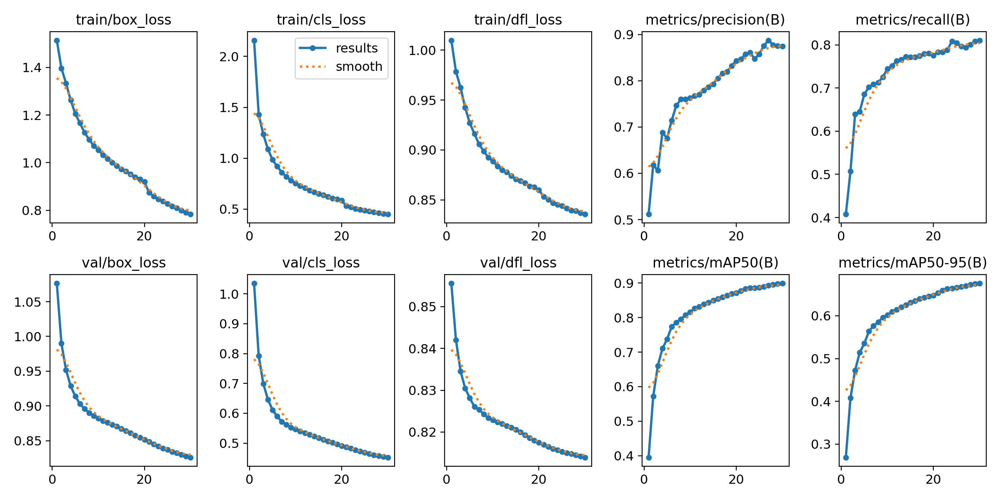

In [ ]:
display.Image('RTSD_YOLO12s/yolo12s/results.png', width=1200, height=600)

## Проверка работы моделей YOLO 11 и YOLO 12

In [ ]:
# Загрузка модели YOLO 11
model_11 = YOLO("RTSD_YOLO11s/yolo11s/weights/best.pt").to(device)

In [ ]:
# Загрузка модели YOLO 12
model_12 = YOLO("RTSD_YOLO12s/yolo12s/weights/best.pt").to(device)

In [ ]:
# Путь к локальному шрифту
FONT_PATH = "DejaVuSans.ttf"
# if not os.path.exists(FONT_PATH):
#     raise FileNotFoundError(f"[ERROR] Шрифт DejaVuSans.ttf не найден по пути: {FONT_PATH}")

# Проверка наличия аудио в видео

def has_audio_stream(video_path: str) -> bool:
    try:
        result = subprocess.run(
            ["ffprobe", "-loglevel", "error",
             "-select_streams", "a",
             "-show_entries", "stream=codec_type",
             "-of", "csv=p=0", video_path],
            stdout=subprocess.PIPE,
            stderr=subprocess.PIPE,
            text=True
        )
        return 'audio' in result.stdout
    except Exception:
        return False

# Обёртка текста

def wrap_text(text, font, max_width):
    words, lines, line = text.split(), [], ''
    for word in words:
        test = f"{line} {word}".strip()
        if font.getbbox(test)[2] <= max_width:
            line = test
        else:
            if line: lines.append(line)
            line = word
    if line: lines.append(line)
    return lines

# Рисуем легенду

def draw_legend(image_np, detections, font_size=18, min_font_size=10):
    h, w = image_np.shape[:2]
    legend_width, pad = 400, 10
    max_text_w = legend_width - 2*pad

    size = font_size
    while size >= min_font_size:
        font = ImageFont.truetype(FONT_PATH, size)
        line_h = size + 6
        lines = []
        for i, (lbl, conf) in enumerate(detections):
            lines.extend(wrap_text(f"{i+1}. {lbl} ({conf:.2f})", font, max_text_w))
        if len(lines)*line_h + 2*pad <= h:
            break
        size -= 1
    else:
        font = ImageFont.truetype(FONT_PATH, min_font_size)
        line_h = min_font_size + 6
        lines = [l for i, (lbl, conf) in enumerate(detections)
                 for l in wrap_text(f"{i+1}. {lbl} ({conf:.2f})", font, max_text_w)]

    canvas_h = max(h, len(lines)*line_h + 2*pad)
    canvas = Image.new('RGB', (w+legend_width, canvas_h), (255,255,255))
    canvas.paste(Image.fromarray(image_np), (0,0))
    draw = ImageDraw.Draw(canvas)
    y = pad
    for line in lines:
        draw.text((w+pad, y), line, fill='black', font=font)
        y += line_h
    return np.array(canvas)

# Обработка кадра

def process_and_legend(image: Image.Image, model, conf_thresh, thickness, font_size):
    arr = np.array(image)
    results = model(arr, conf=conf_thresh, verbose=False)
    draw = ImageDraw.Draw(image)
    try:
        font = ImageFont.truetype(FONT_PATH, font_size)
    except:
        font = ImageFont.load_default()
    dets = []
    for idx, box in enumerate(results[0].boxes):
        x1,y1,x2,y2 = map(int, box.xyxy[0].tolist())
        cid,conf = int(box.cls[0]), float(box.conf[0])
        lbl = model.model.names.get(cid, f"Class {cid}")
        draw.rectangle([x1,y1,x2,y2], outline='red', width=thickness)
        txt = str(idx+1)
        tb = draw.textbbox((0,0), txt, font=font)
        tw,th = tb[2]-tb[0], tb[3]-tb[1]
        draw.rectangle([x1, y1-th-4, x1+tw+4, y1], fill='red')
        draw.text((x1+2, y1-th-2), txt, fill='white', font=font)
        dets.append((lbl, conf))
    return draw_legend(np.array(image), dets, font_size)

# Главная функция

def detect_objects(model: YOLO, source_path: str, is_video=False,
                   confidence_threshold=0.5, box_thickness=2,
                   font_size=18, save=True, output_path="output") -> str:
    source = Path(source_path)
    if not source.exists(): raise FileNotFoundError(f"{source} not found")
    os.makedirs(output_path, exist_ok=True)

    if is_video:
        cap = cv2.VideoCapture(str(source))
        total = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
        fps = cap.get(cv2.CAP_PROP_FPS)
        cap.release()

        # подготовка первого фрейма для определения размеров
        cap = cv2.VideoCapture(str(source))
        ret, frame = cap.read()
        if not ret: raise RuntimeError("Cannot read video")
        base_img = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        ann0 = process_and_legend(base_img, model, confidence_threshold, box_thickness, font_size)
        h0, w0 = ann0.shape[:2]
        raw_path = Path(output_path) / f"raw_{uuid4().hex}.mp4"
        writer = cv2.VideoWriter(str(raw_path), cv2.VideoWriter_fourcc(*'mp4v'), fps, (w0, h0))
        writer.write(cv2.cvtColor(ann0, cv2.COLOR_RGB2BGR))

        for _ in tqdm(range(total-1), desc="Processing video"):
            ret, frame = cap.read()
            if not ret: break
            img = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            ann = process_and_legend(img, model, confidence_threshold, box_thickness, font_size)
            writer.write(cv2.cvtColor(ann, cv2.COLOR_RGB2BGR))
        cap.release(); writer.release()

        final = Path(output_path) / f"annot_{source.stem}.mp4"
        # ffmpeg сборка
        if has_audio_stream(str(source)):
            cmd = [
                'ffmpeg','-y','-i', str(raw_path),'-i', str(source),
                '-c:v','libx264','-pix_fmt','yuv420p','-c:a','aac',
                '-map','0:v','-map','1:a','-shortest','-movflags','+faststart', str(final)
            ]
        else:
            cmd = [
                'ffmpeg','-y','-i', str(raw_path),
                '-f','lavfi','-i','anullsrc=channel_layout=stereo:sample_rate=44100',
                '-c:v','libx264','-pix_fmt','yuv420p','-preset','fast',
                '-c:a','aac','-shortest','-movflags','+faststart', str(final)
            ]
        subprocess.run(cmd, stdout=subprocess.DEVNULL, stderr=subprocess.DEVNULL)
        raw_path.unlink()

        if save:
            display(Video(str(final), embed=True, width=min(640, w0)))
        return str(final)

    else:
        img = Image.open(str(source)).convert('RGB')
        ann = process_and_legend(img, model, confidence_threshold, box_thickness, font_size)
        out_img = Path(output_path) / f"annot_{source.name}"
        if save:
            cv2.imwrite(str(out_img), cv2.cvtColor(ann, cv2.COLOR_RGB2BGR))
            print(f"[INFO] Image saved to {out_img}")
        plt.figure(figsize=(15,10))
        plt.imshow(ann)
        plt.axis('off')
        plt.show()
        return str(out_img)

### Инференс YOLO 11

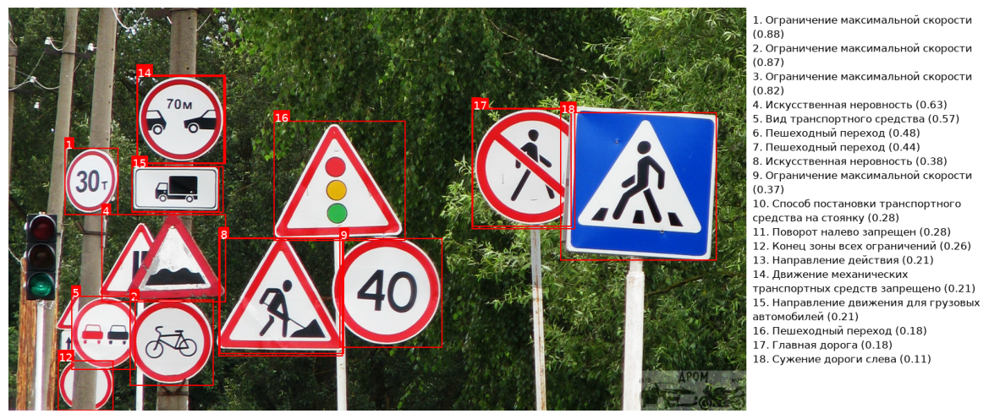

'output\\annot_example_1.png'

In [ ]:
detect_objects(
    model=model_11,
    source_path="example_1.png",
    is_video=False,
    confidence_threshold=0.1,
    save=False
)

Видим, что на рандомных картинках модель отрабатывает очень плохо, практически ни один знак не распознан правильно, при том что порог уверенности стоит минимальный.

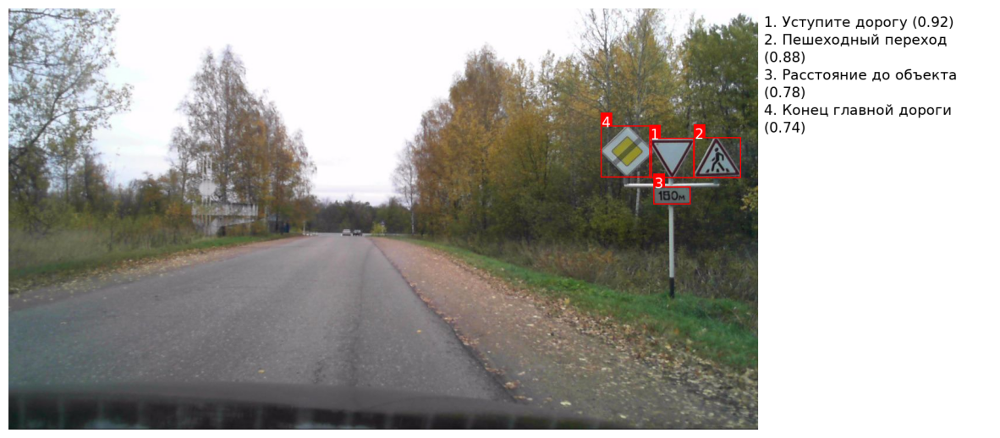

'output\\annot_example_3.jpg'

In [ ]:
detect_objects(
    model=model_11,
    source_path="example_3.jpg",
    is_video=False,
    confidence_threshold=0.5,
    font_size=24,
    save=False
)

На картинках взятых из валидационных данных нашего датасета детекция получше, все знаки распознаны верно, при пороге уверенности 0.5.

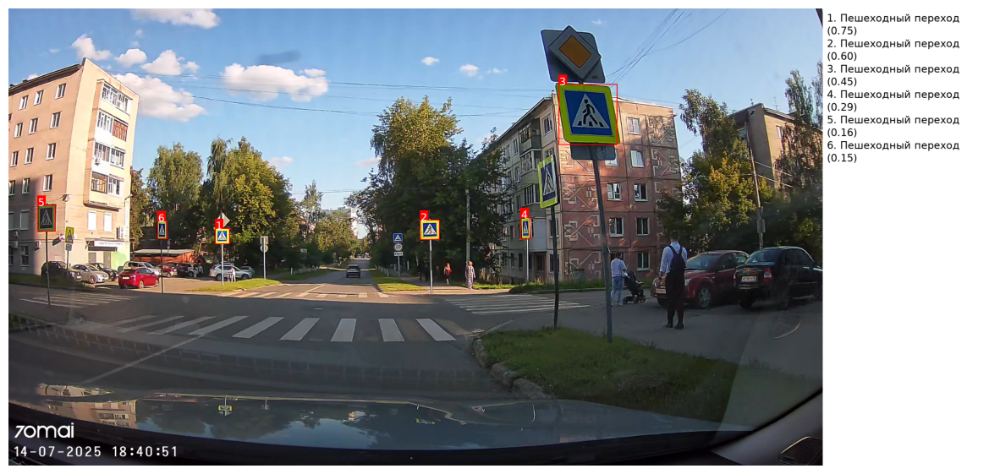

'output\\annot_example_4.png'

In [ ]:
detect_objects(
    model=model_11,
    source_path="example_4.png",
    is_video=False,
    confidence_threshold=0.1,
    font_size=24,
    save=False
)

На картинках, взятых с моего видеорегистратора при пороге уверенности 0.1 неплохо нашлись знаки *Пешеходного перехода*, но знак *Главная дорога* не нашелся.

In [ ]:
detect_objects(
    model=model_11,
    source_path="demo_video_2.mp4",
    is_video=True,
    confidence_threshold=0.2,
    font_size=24,
    save=True
)

Видео с детекцией для *YOLO 11* выложил в папку [output](https://drive.google.com/drive/folders/1WQq4OCl9uNn3Ug4l9bm4XSirKbX3giSl?usp=sharing) на *Google Диске*. Иначе файл `.ipynb` с проектом начинает много весить и не открывается в Colab (ошибка out of memory)

### Инференс YOLO 12

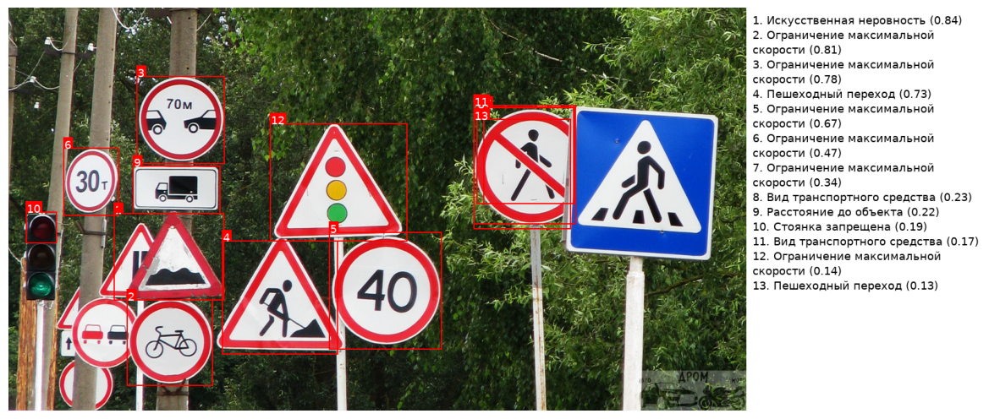

'output\\annot_example_1.png'

In [ ]:
detect_objects(
    model=model_12,
    source_path="example_1.png",
    is_video=False,
    confidence_threshold=0.1,
    save=False
)

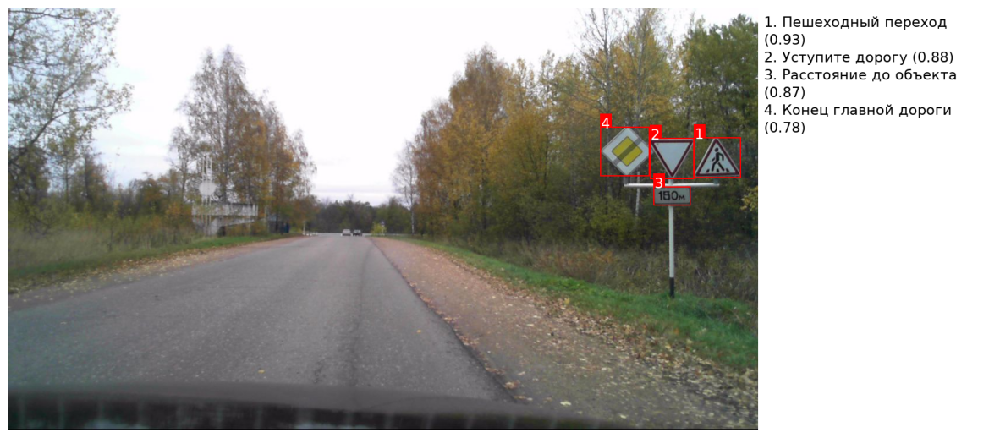

'output\\annot_example_3.jpg'

In [ ]:
detect_objects(
    model=model_12,
    source_path="example_3.jpg",
    is_video=False,
    confidence_threshold=0.5,
    font_size=24,
    save=False
)

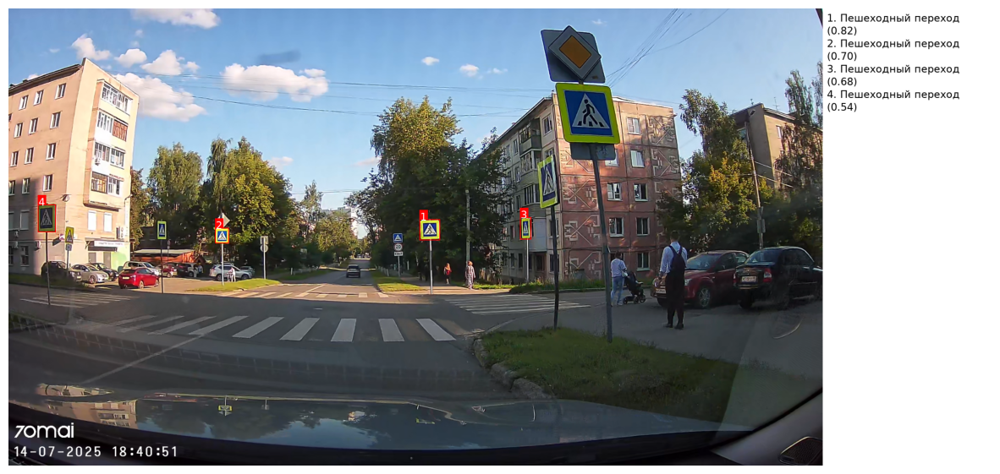

'output\\annot_example_4.png'

In [ ]:
detect_objects(
    model=model_12,
    source_path="example_4.png",
    is_video=False,
    confidence_threshold=0.1,
    font_size=24,
    save=False
)

In [ ]:
detect_objects(
    model=model_12,
    source_path="demo_video_3.mp4",
    is_video=True,
    confidence_threshold=0.2,
    font_size=24,
    save=True
)

Видео с детекцией для *YOLO 12* выложил в папку [output](https://drive.google.com/drive/folders/1WQq4OCl9uNn3Ug4l9bm4XSirKbX3giSl?usp=sharing) на *Google Диске*.

**Для дальнейшего инференса была выбрана модель *YOLO11s* с лучшими весами *best.pt***

## Приложение на Gradio

Для запуска приложения в Google Colab ячейке в переменных средах должны находится следующие файлы:

- Шрифт *DejaVuSans.ttf*
- *best.pt* - файл с весами лучшей модели
- *mini_demo_1.mp4* - пример видео
- *example_3.jpg* - пример картинки

Также необходимо установить библиотеки:

*!pip install gradio*

*!pip install ultralytics (если не установили в самом начале ноутбука)*

In [ ]:
import os
import cv2
import subprocess
from uuid import uuid4
from pathlib import Path
import numpy as np
from PIL import Image, ImageDraw, ImageFont
import gradio as gr
from ultralytics import YOLO
import torch

# Путь к локальному шрифту
FONT_PATH = "DejaVuSans.ttf"
# if not FONT_PATH.exists():
#     raise FileNotFoundError(f"[ERROR] Шрифт DejaVuSans.ttf не найден: {FONT_PATH}")

# Функции для детекции

def has_audio_stream(video_path: str) -> bool:
    try:
        result = subprocess.run(
            ["ffprobe", "-loglevel", "error",
             "-select_streams", "a",
             "-show_entries", "stream=codec_type",
             "-of", "csv=p=0", video_path],
            stdout=subprocess.PIPE,
            stderr=subprocess.PIPE,
            text=True
        )
        return 'audio' in result.stdout
    except:
        return False


def wrap_text(text, font, max_width):
    words, lines, line = text.split(), [], ''
    for word in words:
        test = f"{line} {word}".strip()
        if font.getbbox(test)[2] <= max_width:
            line = test
        else:
            if line: lines.append(line)
            line = word
    if line: lines.append(line)
    return lines


def draw_legend(img_np, dets, font_size, min_font_size=10):
    h, w = img_np.shape[:2]
    legend_w, pad = 400, 10
    max_text_w = legend_w - 2*pad
    size = font_size
    while size >= min_font_size:
        font = ImageFont.truetype(str(FONT_PATH), size)
        line_h = size + 6
        lines = []
        for i, (lbl, conf) in enumerate(dets):
            lines.extend(wrap_text(f"{i+1}. {lbl} ({conf:.2f})", font, max_text_w))
        if len(lines)*line_h + 2*pad <= h:
            break
        size -= 1
    else:
        font = ImageFont.truetype(str(FONT_PATH), min_font_size)
        line_h = min_font_size + 6
        lines = [l for i,(lbl,conf) in enumerate(dets) for l in wrap_text(f"{i+1}. {lbl} ({conf:.2f})", font, max_text_w)]
    canvas_h = max(h, len(lines)*line_h + 2*pad)
    canvas = Image.new('RGB', (w+legend_w, canvas_h), (255,255,255))
    canvas.paste(Image.fromarray(img_np), (0,0))
    draw = ImageDraw.Draw(canvas)
    y = pad
    for line in lines:
        draw.text((w+pad, y), line, fill='black', font=font)
        y += line_h
    return np.array(canvas)


def process_frame(img_pil, model, conf_thresh, thickness, font_size):
    thickness = int(thickness)
    font_size = int(font_size)
    img_np = np.array(img_pil)
    results = model(img_np, conf=conf_thresh, verbose=False)
    draw = ImageDraw.Draw(img_pil)
    try:
        font = ImageFont.truetype(str(FONT_PATH), font_size)
    except:
        font = ImageFont.load_default()
    dets = []
    for idx, box in enumerate(results[0].boxes):
        x1,y1,x2,y2 = map(int, box.xyxy[0].tolist())
        cid,conf = int(box.cls[0]), float(box.conf[0])
        lbl = model.model.names.get(cid, f"Class {cid}")
        draw.rectangle([x1,y1,x2,y2], outline='red', width=thickness)
        txt = str(idx+1)
        tb = draw.textbbox((0,0), txt, font=font)
        tw,th = tb[2]-tb[0], tb[3]-tb[1]
        draw.rectangle([x1, y1-th-4, x1+tw+4, y1], fill='red')
        draw.text((x1+2, y1-th-2), txt, fill='white', font=font)
        dets.append((lbl, conf))
    return draw_legend(np.array(img_pil), dets, font_size)


def detect_objects(model, source, is_video, conf_thresh, thickness, font_size, save, out_dir):
    os.makedirs(out_dir, exist_ok=True)
    src = Path(source)
    if not src.exists():
        raise FileNotFoundError(f"{src} not found")
    if is_video:
        cap = cv2.VideoCapture(str(src))
        total = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
        fps = cap.get(cv2.CAP_PROP_FPS)
        ret, frame = cap.read()
        if not ret: raise RuntimeError("Cannot read video")
        pil = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
        ann0 = process_frame(pil, model, conf_thresh, thickness, font_size)
        h0, w0 = ann0.shape[:2]
        raw = Path(out_dir)/f"raw_{uuid4().hex}.mp4"
        writer = cv2.VideoWriter(str(raw), cv2.VideoWriter_fourcc(*'mp4v'), fps, (w0,h0))
        writer.write(cv2.cvtColor(ann0, cv2.COLOR_RGB2BGR))
        for _ in range(total-1):
            ret, frame = cap.read()
            if not ret: break
            pil = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
            ann = process_frame(pil, model, conf_thresh, thickness, font_size)
            writer.write(cv2.cvtColor(ann, cv2.COLOR_RGB2BGR))
        cap.release(); writer.release()
        final = Path(out_dir)/f"annot_{src.stem}.mp4"
        if has_audio_stream(str(src)):
            cmd = ['ffmpeg','-y',
                   '-i',str(raw),
                   '-i',str(src),
                   '-c:v','libx264',
                   '-pix_fmt','yuv420p',
                   '-c:a','aac','-map',
                   '0:v','-map','1:a',
                   '-shortest',
                   '-movflags','+faststart',
                   str(final)
                ]
        else:
            cmd = ['ffmpeg','-y',
                   '-i',str(raw),
                   '-f','lavfi',
                   '-i','anullsrc=channel_layout=stereo:sample_rate=44100',
                   '-c:v','libx264',
                   '-pix_fmt','yuv420p',
                   '-preset','fast','-c:a',
                   'aac','-shortest',
                   '-movflags','+faststart',
                   str(final)
                ]
        subprocess.run(cmd, stdout=subprocess.DEVNULL, stderr=subprocess.DEVNULL)
        raw.unlink()
        if save: return str(final)
        else: return str(final)
    else:
        pil = Image.open(str(src)).convert('RGB')
        ann = process_frame(pil, model, conf_thresh, thickness, font_size)
        out_file = Path(out_dir)/f"annot_{src.name}"
        if save:
            cv2.imwrite(str(out_file), cv2.cvtColor(ann, cv2.COLOR_RGB2BGR))
            return str(out_file)
        return ann

# Загружаем модель
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = YOLO("best.pt")
model.to(device)

css = """
.gradio-container {
    max-width: 80% !important;
    margin: auto;
}

.tab-content {
    max-width: 1000px;
    margin: auto;
    padding: 20px;
}

.fixed-size {
    width: 480px !important;
    height: 300px !important;
    overflow: hidden;
    display: flex;
    justify-content: center;
    align-items: center;
    border: 1px solid #ccc;
}
.fixed-size img, .fixed-size video {
    max-width: 100% !important;
    max-height: 100% !important;
    object-fit: contain;
}
.fixed-save {
    width: 480px !important;
    height: 80px !important;
    display: flex;
    align-items: center;
    justify-content: center;
    border: 1px solid #ccc;
    overflow: hidden;
}
"""

with gr.Blocks(css=css) as demo:
    gr.Markdown("## Traffic Sign Detection With YOLO")
    with gr.Tabs():
        with gr.TabItem("Readme"):
            with gr.Column(elem_classes="tab-content"):
                with open("README_FOR_APP.md", encoding="utf-8") as f:
                    gr.Markdown(f.read())

        with gr.TabItem("Image"):
            with gr.Column(elem_classes="tab-content"):
                with gr.Row():
                    with gr.Column(elem_classes="fixed-size"):
                        img_input = gr.Image(label="Upload Image", type="filepath")
                    with gr.Column(elem_classes="fixed-size"):
                        img_preview = gr.Image(label="Preview")
            ex_img = gr.Examples(
                examples=["example_3.jpg"],
                inputs=[img_input],
                label="Example Images"
            )
            thr_i = gr.Slider(0.0, 1.0, value=0.5, step=0.05, label="Confidence Threshold")
            thickness_i = gr.Slider(1, 10, value=2, step=1, label="Box Thickness")
            font_i = gr.Slider(8, 72, value=18, step=1, label="Font Size")
            with gr.Column(elem_classes="fixed-save"):
                img_file = gr.File(label="Save Image File")
            with gr.Row():
                btn_preview_i = gr.Button("Run Image")
                btn_save_i = gr.Button("Save Image")
                btn_clear_i = gr.Button("Clear")
        with gr.TabItem("Video"):
            with gr.Column(elem_classes="tab-content"):
                with gr.Row():
                    with gr.Column(elem_classes="fixed-size"):
                        vid_input = gr.Video(label="Upload Video")
                    with gr.Column(elem_classes="fixed-size"):
                        vid_preview = gr.Video(label="Preview")
            ex_vid = gr.Examples(
                examples=["mini_demo_1.mp4"],
                inputs=[vid_input],
                label="Example Videos"
            )
            thr_v = gr.Slider(0.0, 1.0, value=0.5, step=0.05, label="Confidence Threshold")
            thickness_v = gr.Slider(1, 10, value=2, step=1, label="Box Thickness")
            font_v = gr.Slider(8, 72, value=18, step=1, label="Font Size")
            with gr.Column(elem_classes="fixed-save"):
                vid_file = gr.File(label="Save Video File")
            with gr.Row():
                btn_preview_v = gr.Button("Run Video")
                btn_save_v = gr.Button("Save Video")
                btn_clear_v = gr.Button("Clear")

    # Callbacks
    btn_preview_i.click(lambda f, t, th, fs: detect_objects(model, f, False, t, th, fs, False, 'output'),
                        [img_input, thr_i, thickness_i, font_i], img_preview)
    btn_save_i.click(lambda f, t, th, fs: detect_objects(model, f, False, t, th, fs, True, 'output'),
                     [img_input, thr_i, thickness_i, font_i], img_file)
    btn_clear_i.click(lambda: (None, 0.5, 2, 18, None, None), [],
                      [img_input, thr_i, thickness_i, font_i, img_preview, img_file])

    btn_preview_v.click(lambda f, t, th, fs: detect_objects(model, f, True, t, th, fs, False, 'output'),
                        [vid_input, thr_v, thickness_v, font_v], vid_preview)
    btn_save_v.click(lambda f, t, th, fs: detect_objects(model, f, True, t, th, fs, True, 'output'),
                     [vid_input, thr_v, thickness_v, font_v], vid_file)
    btn_clear_v.click(lambda: (None, 0.5, 2, 18, None, None), [],
                      [vid_input, thr_v, thickness_v, font_v, vid_preview, vid_file])

if __name__ == "__main__":
    demo.launch(server_name='0.0.0.0', server_port=7860, share=True)


## Деплой приложения на Hugging Face

На платформе **Hugging Face** было выгружено приложение [Traffic Sign Detection With YOLO](https://huggingface.co/spaces/NizaevEdgar/TrafficSignDetectionWithYolo).

### Пример файла README

**📘 Traffic Sign Detection With YOLO** — это интерактивное приложение на основе Gradio, которое позволяет выполнять детекцию дорожных знаков на изображениях и видео с использованием модели YOLO.

#### 🚀 Стек технологий
- **YOLO11s (Ultralytics)** — модель детекции объектов
- **PyTorch** — фреймворк глубокого обучения
- **OpenCV** — обработка изображений и видео
- **Gradio** — веб-интерфейс для ML-приложений
- **Pillow (PIL)** — работа с изображениями
- **FFmpeg** — обработка аудио и видео
- **Python 3.10+**

#### 📂 Структура приложения
- Загрузка изображения или видео
- Запуск детекции с настраиваемыми параметрами:
    - Порог уверенности (`Confidence Threshold`)
    - Толщина рамки (`Box Thickness`)
    - Размер шрифта (`Font Size`)
- Сохранение аннотированных файлов
- Предпросмотр результата
- Генерация текстовой легенды сбоку

#### 🧭 Как пользоваться:
1. Перейдите на вкладку `Image` или `Video`.
2. Загрузите изображение (`.jpg`, `.png`) или видео (`.mp4`).
3. Отрегулируйте параметры, если необходимо.
4. Нажмите `Run` для предварительного просмотра.
5. Нажмите `Save` для сохранения результата.
6. Используйте `Clear` для очистки полей.

#### 📂 Примеры

- `Example Images` — изображение
- `Example Videos` — видео